In [323]:
#from shapely.geometry import Point
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from haversine import haversine
from datetime import datetime
import seaborn as sns
import matplotlib
from matplotlib.pyplot import figure
from matplotlib.dates import DateFormatter
from matplotlib.lines import Line2D
import numpy as np

In [384]:
df_initial = pd.read_csv(r'../../data/tidy/large/vehicle-locations-mapped-powertrain-weight-consistent-lat-long-oct2021-sep2022.csv', delimiter=',', skiprows=0, low_memory=False)

In [385]:
df=df_initial.copy()

In [386]:
len(df.loc[df['Stop']==0]) / len(df) * 100

0.2386739649625211

In [387]:
df=df.loc[df['Stop']!=0]

In [388]:
df.loc[df['Stop']==0]

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Onboard,Bike,Daytype,Hour,Minute,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb)


In [389]:
len(df.Vehicle.unique())

213

In [390]:
df.loc[df['ServiceDateTime'].isna()]

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Onboard,Bike,Daytype,Hour,Minute,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb)


In [391]:
df["ServiceDateTime"] = pd.to_datetime(df['ServiceDateTime'], errors="coerce")

In [392]:
print(df['ServiceDateTime'].isna().sum())

0


In [393]:
df.sort_values(by=['Vehicle','ServiceDateTime'], ascending=True, inplace=True)

In [394]:
df[["Vehicle", "ServiceDateTime"]]

,Vehicle,ServiceDateTime
1365147,1205,2021-10-01 06:43:49
1365148,1205,2021-10-01 06:51:53
1365830,1205,2021-10-01 06:51:53
1365831,1205,2021-10-01 06:52:53
1365832,1205,2021-10-01 06:54:38
...,...,...
15569308,7902,2022-09-30 23:56:37
15569309,7902,2022-09-30 23:56:58
15569310,7902,2022-09-30 23:58:24
15569311,7902,2022-09-30 23:58:42


In [395]:
# Calculate time delta
df['time_delta'] = df.groupby(['Vehicle', 'Date'])['ServiceDateTime'].diff()

# Convert time delta to seconds, filling NaN values with 0
df['time_delta_in_seconds'] = df['time_delta'].dt.total_seconds().fillna(0).astype(int)

# Drop the 'time_delta' column as it's not needed
df.drop(columns=['time_delta'], inplace=True)


In [396]:
## vectorized version of computing distances

# Function to compute distances between consecutive rows
def compute_distances(lat1, lon1, lat2, lon2):
    coords1 = np.column_stack((lon1, lat1))
    coords2 = np.column_stack((lon2, lat2))
    distances = np.array([haversine(coord1, coord2, unit='mi') for coord1, coord2 in zip(coords1, coords2)])
    return distances

# Shift the columns to get the next row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Lat'] = df['Lat'].shift(1)
df['Prev_Lon'] = df['Lon'].shift(1)

# Calculate distances using the compute_distances function
distances = compute_distances(df['Prev_Lat'], df['Prev_Lon'], df['Lat'], df['Lon'])

# Set distance to 0 where the vehicle or date is different
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
distances[~(same_vehicle & same_date)] = 0

# Assign the distances to the 'dist' column
df['dist'] = distances

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Lat', 'Prev_Lon'], inplace=True)

In [397]:
## vectorized version of computing speeds

# Function to compute speed from distance and time
def compute_speed(distance, time_diff):
    speed = distance / time_diff
    return speed

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in hours
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_hours = time_diff.dt.total_seconds() / 3600.0

# Calculate speeds using the compute_speed function
speeds = compute_speed(df['dist'], time_diff_hours)

# Set speed to 0 where the vehicle or date is different or time_diff_hours is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_hours != 0
zero_distance = df['dist'] == 0

# Assign the speeds to the 'speed' column
df['speed'] = speeds

# Set speed to 0 when any of the conditions are not true or distance is 0
df.loc[~(same_vehicle & same_date & valid_time_diff) | zero_distance, 'speed'] = 0

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_ServiceDateTime'], inplace=True)


In [398]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Speed'] = df['speed'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df['speed'] - df['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df['acc'] = accelerations

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
#df.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')

In [399]:
date_range = (df['ServiceDateTime'].min(), df['ServiceDateTime'].max())
date_range

(Timestamp('2021-10-01 00:00:06'), Timestamp('2022-09-30 23:59:47'))

In [400]:
start_time = pd.to_datetime('2022-08-23 05:00:00', format='%Y-%m-%d %H:%M:%S')
end_time = pd.to_datetime('2022-08-24 05:00:00', format='%Y-%m-%d %H:%M:%S')

plot_data_modified = df.loc[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)].copy()
#plot_data_modified

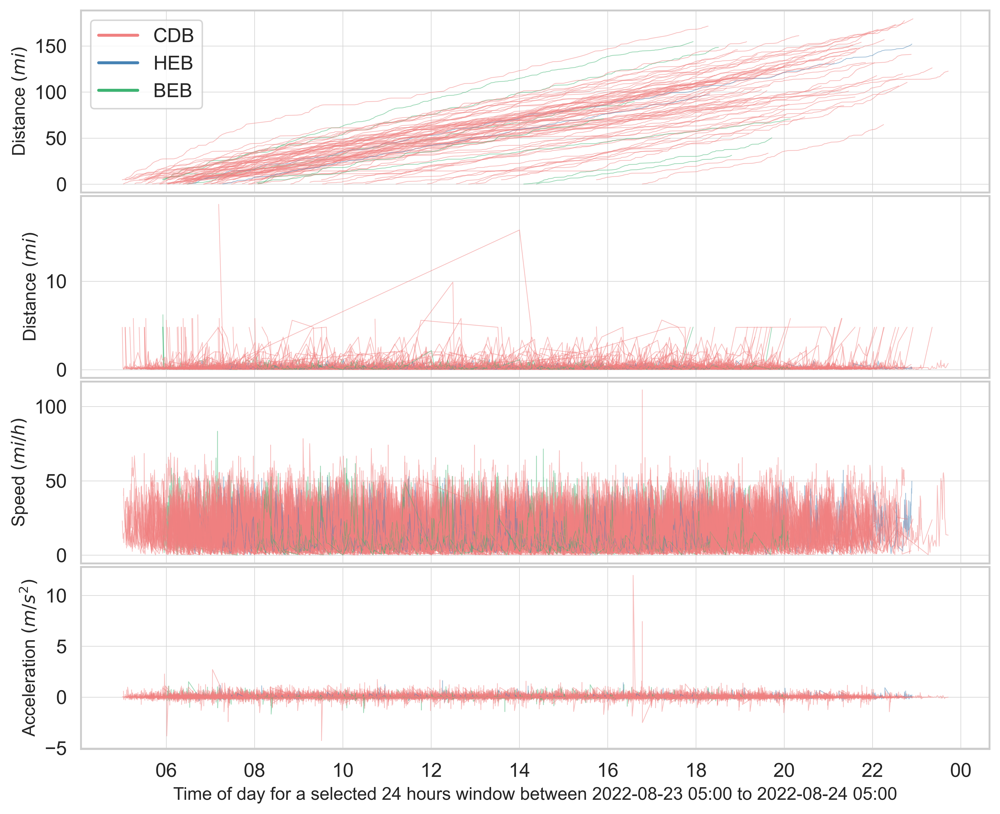

In [401]:
from matplotlib.dates import date2num

# make a facet plot
fig, axs = plt.subplots(nrows=4, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: cumulative distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])


# plot 2: Distance vs time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain = plot_df['Powertrain'].max()
    if powertrain == 'conventional':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain == 'hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)

axs[1].set_ylabel("Distance (mile)", fontsize=12)
axs[1].set_ylabel(r'Distance $(mi)$')
axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)



# Plot 3: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[2].set_ylabel(r'Speed $(mi/h)$')

axs[2].grid(color='lightgrey', linewidth=0.4)
axs[2].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[3].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[3].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[3].set_ylabel(r'Acceleration $(m/s^2)$')

axs[3].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[3].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

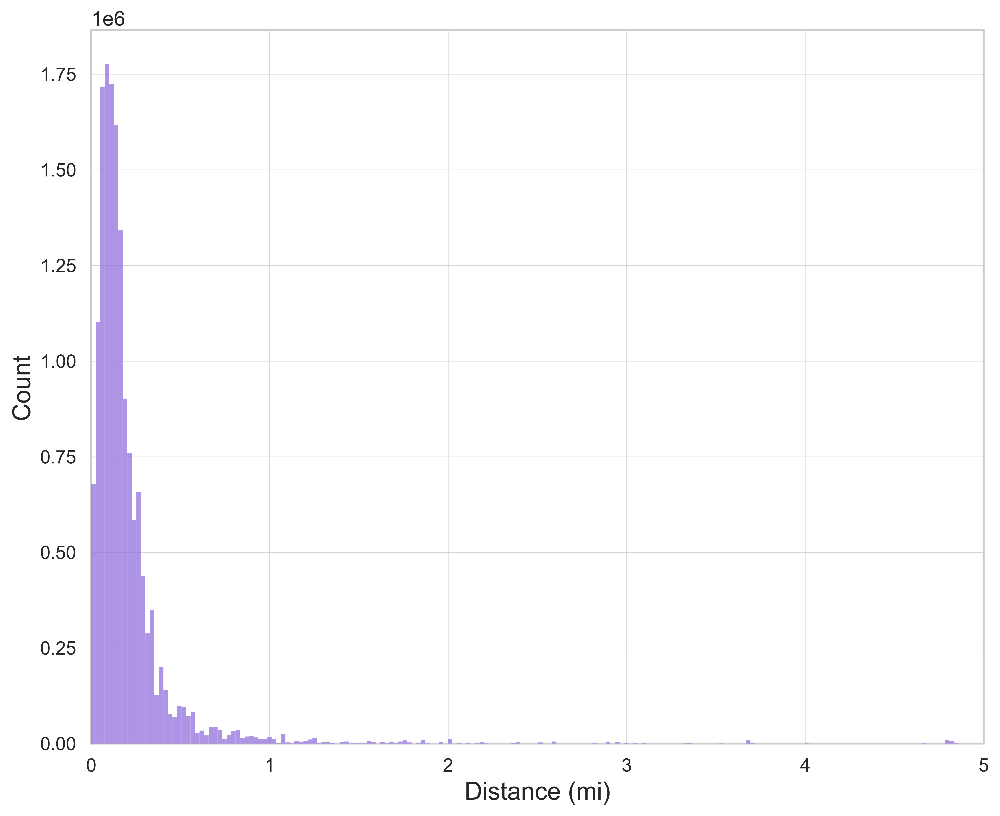

In [402]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['dist'], 
             bins=2000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Distance (mi)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,5)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))


# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)



# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
fig.savefig(r'../../figures/hist-trajectories-distance-Oct2021toSep2022.png', dpi=600, bbox_inches='tight')


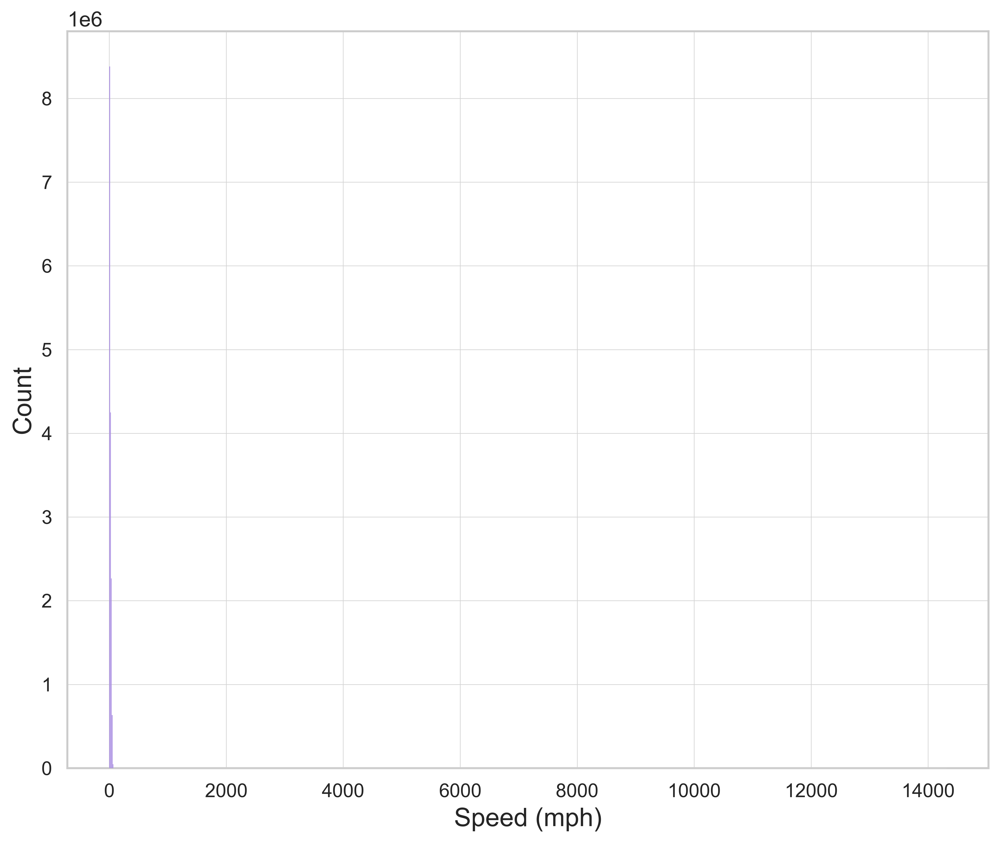

In [403]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['speed'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-speed-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


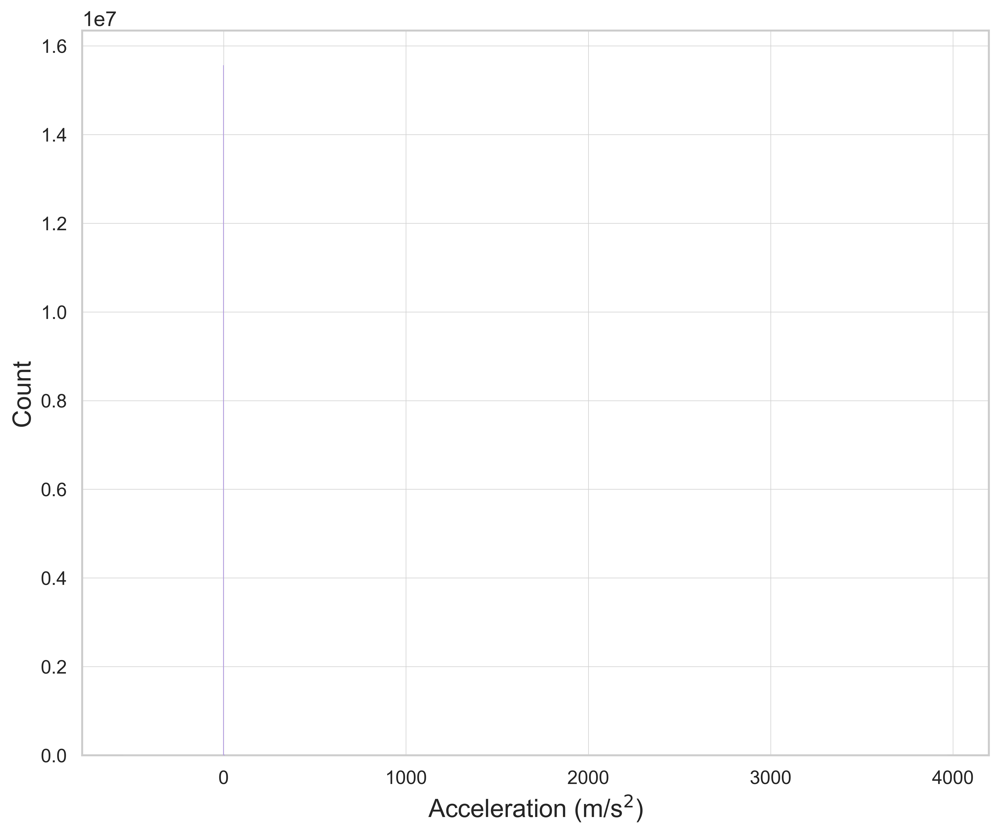

In [404]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['acc'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-acceleration-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


In [405]:
df.loc[df['speed']>100]

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Minute,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb),time_delta_in_seconds,dist,speed,acc
14546270,14546270,14546270,2022-09-08 20:05:13,8920,2022-09-08 00:00:00.000,2022,9,2,SATCo,3979,...,5,13,2022-09-08,electric,NEW FLYER XE35,26900,2,0.058048,104.486085,13.040504
2501706,2501706,2501706,2021-10-25 14:55:53,8602,2021-10-25 00:00:00.000,2021,10,2,SATCo,3365,...,55,53,2021-10-25,electric,PROTERRA CATALYST BE-40,27370,2,0.075487,135.875885,17.195691
492915,492915,492915,2022-04-12 15:00:05,8771,2022-04-12 00:00:00.000,2022,4,2,SATCo,3641,...,0,5,2022-04-12,electric,PROTERRA CATALYST BE-40,27370,2,0.075487,135.875885,16.602653
1220645,1220645,1220645,2022-04-28 14:58:32,8787,2022-04-28 00:00:00.000,2022,4,2,SATCo,3641,...,58,32,2022-04-28,electric,PROTERRA CATALYST BE-40,27370,2,0.075487,135.875885,16.794401
10716597,10716597,10716597,2022-06-06 14:59:29,8826,2022-06-06 00:00:00.000,2022,6,2,SATCo,3783,...,59,29,2022-06-06,electric,PROTERRA CATALYST BE-40,27370,2,0.075487,135.875885,16.140447
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
13335983,13335983,13335983,2022-08-10 16:22:11,8891,2022-08-10 00:00:00.000,2022,8,1,VATCo,3721,...,22,11,2022-08-10,conventional,NEW FLYER XD40,28250,2,0.057978,104.361232,14.494627
11334221,11334221,11334221,2022-06-21 16:09:46,8841,2022-06-21 00:00:00.000,2022,6,1,VATCo,3721,...,9,46,2022-06-21,conventional,NEW FLYER XD40,28250,2,0.057978,104.361232,14.471116
13003596,13003596,13003596,2022-08-02 16:10:17,8883,2022-08-02 00:00:00.000,2022,8,1,VATCo,3721,...,10,17,2022-08-02,conventional,NEW FLYER XD40,28250,2,0.057978,104.361232,14.494627
13382333,13382333,13382333,2022-08-11 16:18:32,8892,2022-08-11 00:00:00.000,2022,8,1,VATCo,3721,...,18,32,2022-08-11,conventional,NEW FLYER XD40,28250,2,0.057978,104.361232,14.466036


In [406]:
len(df.loc[df['speed']>100]) / len(df) * 100

0.003439327062293656

In [407]:
# Remove any speed above 100
df=df.loc[df['speed']<100].copy()

In [408]:
# Calculate time delta
df['time_delta'] = df.groupby(['Vehicle', 'Date'])['ServiceDateTime'].diff()

# Convert time delta to seconds, filling NaN values with 0
df['time_delta_in_seconds'] = df['time_delta'].dt.total_seconds().fillna(0).astype(int)

# Drop the 'time_delta' column as it's not needed
df.drop(columns=['time_delta'], inplace=True)


In [409]:
## vectorized version of computing distances

# Function to compute distances between consecutive rows
def compute_distances(lat1, lon1, lat2, lon2):
    coords1 = np.column_stack((lon1, lat1))
    coords2 = np.column_stack((lon2, lat2))
    distances = np.array([haversine(coord1, coord2, unit='mi') for coord1, coord2 in zip(coords1, coords2)])
    return distances

# Shift the columns to get the next row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Lat'] = df['Lat'].shift(1)
df['Prev_Lon'] = df['Lon'].shift(1)

# Calculate distances using the compute_distances function
distances = compute_distances(df['Prev_Lat'], df['Prev_Lon'], df['Lat'], df['Lon'])

# Set distance to 0 where the vehicle or date is different
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
distances[~(same_vehicle & same_date)] = 0

# Assign the distances to the 'dist' column
df['dist'] = distances

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Lat', 'Prev_Lon'], inplace=True)

In [410]:
## vectorized version of computing speeds

# Function to compute speed from distance and time
def compute_speed(distance, time_diff):
    speed = distance / time_diff
    return speed

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in hours
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_hours = time_diff.dt.total_seconds() / 3600.0

# Calculate speeds using the compute_speed function
speeds = compute_speed(df['dist'], time_diff_hours)

# Set speed to 0 where the vehicle or date is different or time_diff_hours is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_hours != 0
zero_distance = df['dist'] == 0

# Assign the speeds to the 'speed' column
df['speed'] = speeds

# Set speed to 0 when any of the conditions are not true or distance is 0
df.loc[~(same_vehicle & same_date & valid_time_diff) | zero_distance, 'speed'] = 0

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_ServiceDateTime'], inplace=True)


In [411]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Speed'] = df['speed'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df['speed'] - df['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df['acc'] = accelerations

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
df.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')

In [412]:
date_range = (df['ServiceDateTime'].min(), df['ServiceDateTime'].max())
date_range

(Timestamp('2021-10-01 00:00:06'), Timestamp('2022-09-30 23:59:47'))

In [413]:
start_time = pd.to_datetime('2022-08-23 05:00:00', format='%Y-%m-%d %H:%M:%S')
end_time = pd.to_datetime('2022-08-24 05:00:00', format='%Y-%m-%d %H:%M:%S')

plot_data_modified = df.loc[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)].copy()
#plot_data_modified

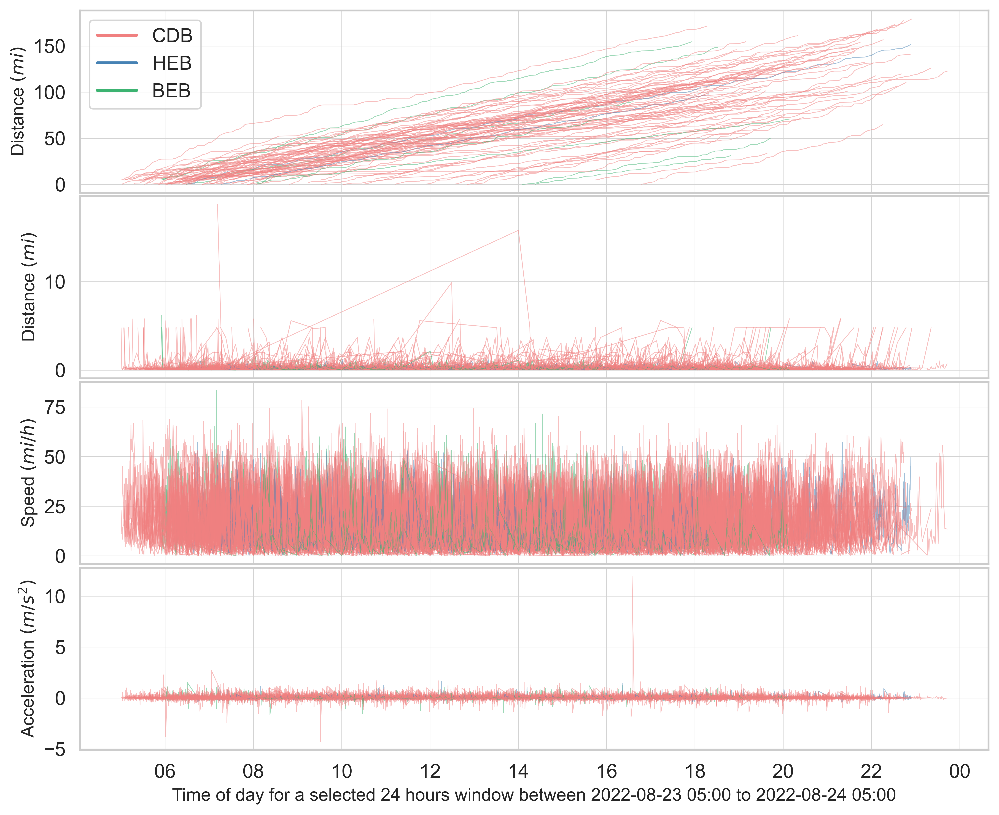

In [414]:
from matplotlib.dates import date2num

# make a facet plot
fig, axs = plt.subplots(nrows=4, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: cumulative distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])


# plot 2: Distance vs time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain = plot_df['Powertrain'].max()
    if powertrain == 'conventional':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain == 'hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)

axs[1].set_ylabel("Distance (mile)", fontsize=12)
axs[1].set_ylabel(r'Distance $(mi)$')
axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)



# Plot 3: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[2].set_ylabel(r'Speed $(mi/h)$')

axs[2].grid(color='lightgrey', linewidth=0.4)
axs[2].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[3].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[3].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[3].set_ylabel(r'Acceleration $(m/s^2)$')

axs[3].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[3].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

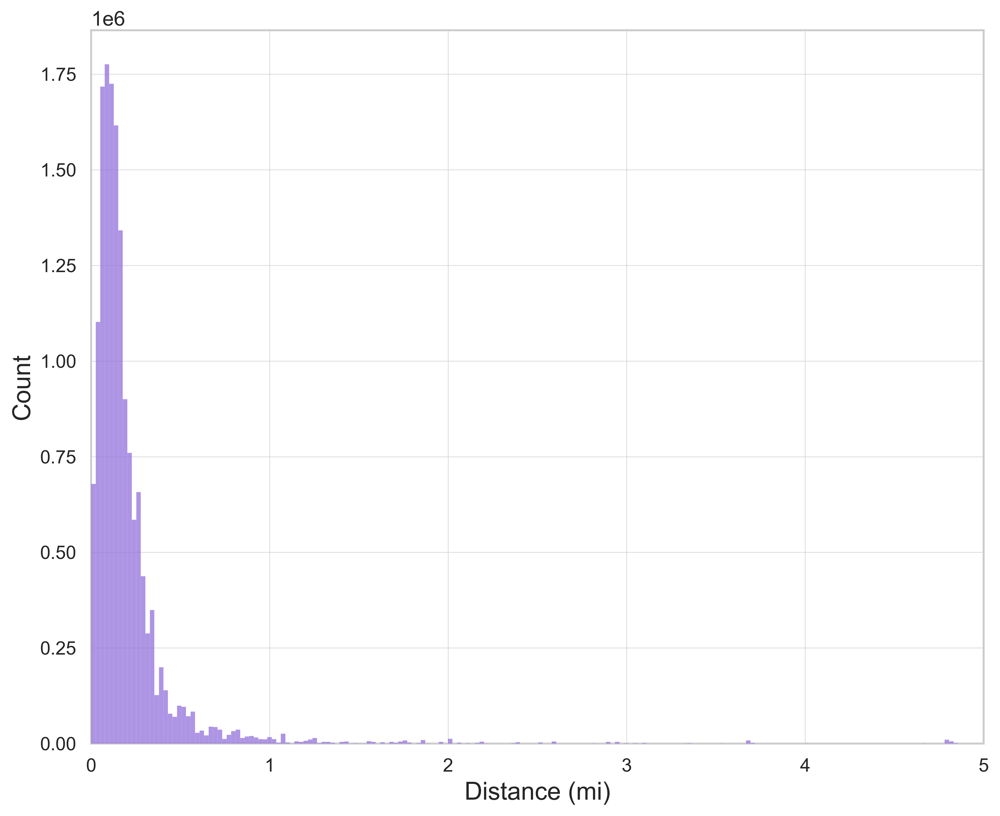

In [415]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['dist'], 
             bins=2000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Distance (mi)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,5)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))


# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)



# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
fig.savefig(r'../../figures/hist-trajectories-distance-Oct2021toSep2022.png', dpi=600, bbox_inches='tight')


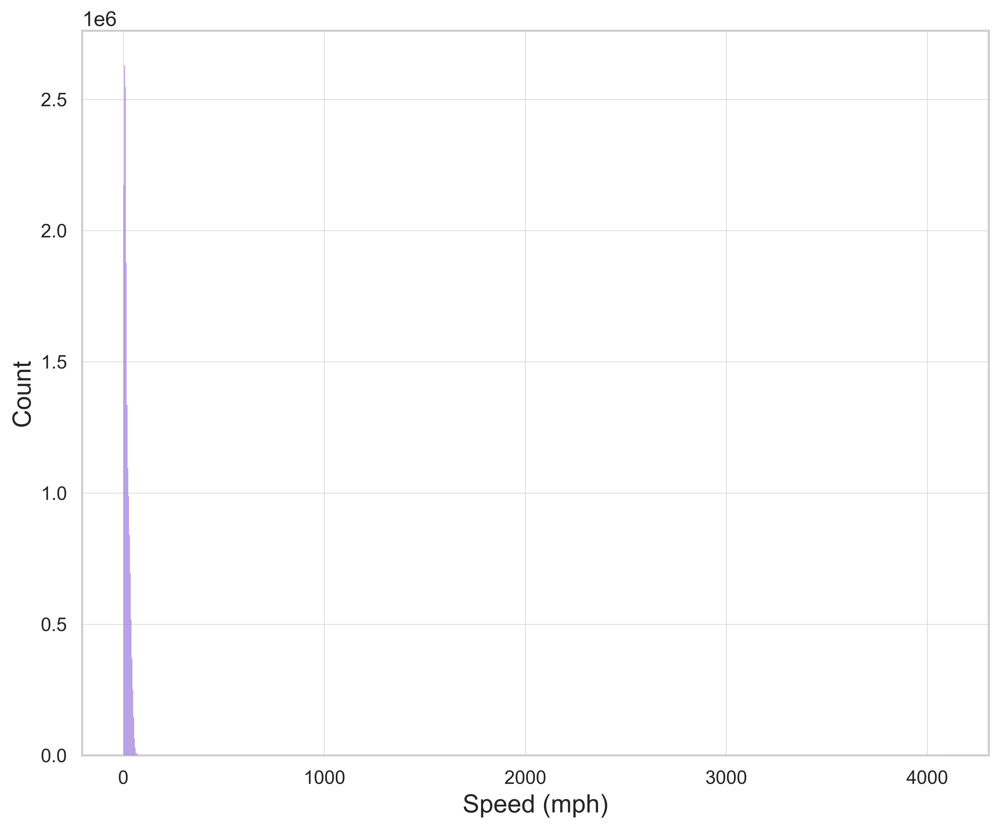

In [416]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['speed'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-speed-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


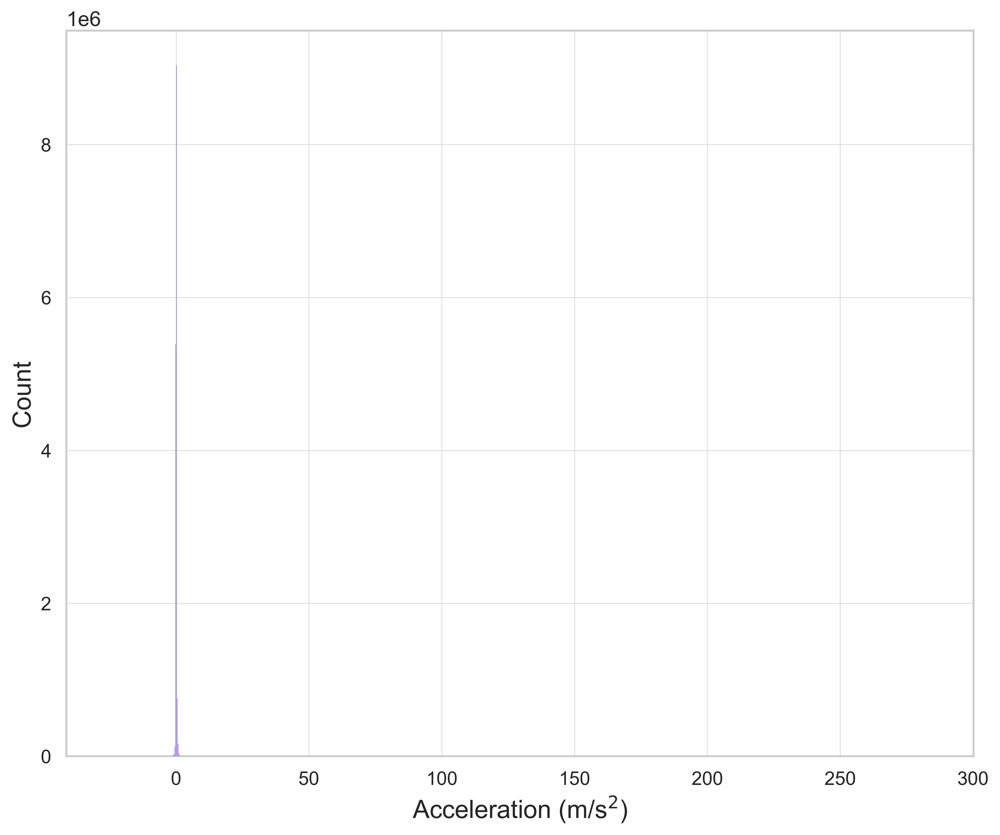

In [417]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['acc'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-acceleration-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


In [418]:
len(df.loc[df['speed']>100]) / len(df) * 100

0.0011293701169180414

In [419]:
df = df.loc[df['speed'] < 100]

In [420]:
len(df.loc[df['acc']>5]) / len(df) * 100

0.008771968101094142

In [421]:
df = df.loc[(df['acc'] < 5) & (df['acc'] > -5)]

In [422]:
start_time = pd.to_datetime('2022-08-23 05:00:00', format='%Y-%m-%d %H:%M:%S')
end_time = pd.to_datetime('2022-08-24 05:00:00', format='%Y-%m-%d %H:%M:%S')

plot_data_modified = df.loc[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)].copy()
#plot_data_modified

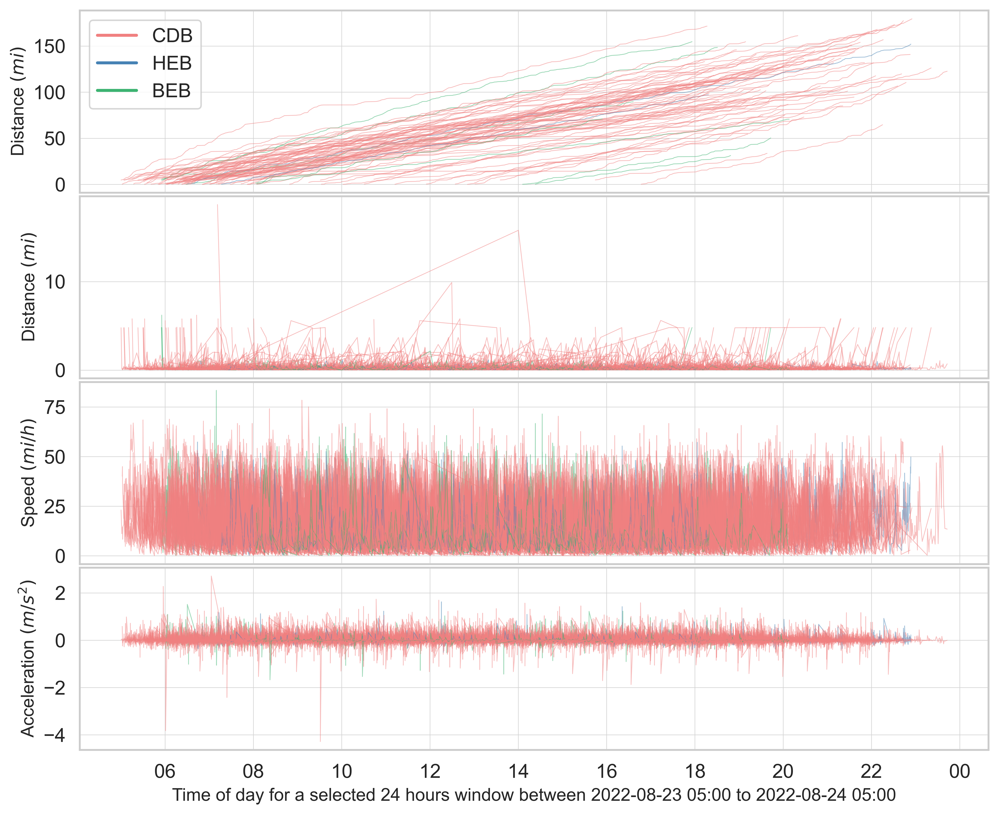

In [423]:
from matplotlib.dates import date2num

# make a facet plot
fig, axs = plt.subplots(nrows=4, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: cumulative distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])


# plot 2: Distance vs time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain = plot_df['Powertrain'].max()
    if powertrain == 'conventional':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain == 'hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["dist"], marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)

axs[1].set_ylabel("Distance (mile)", fontsize=12)
axs[1].set_ylabel(r'Distance $(mi)$')
axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)



# Plot 3: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[2].set_ylabel(r'Speed $(mi/h)$')

axs[2].grid(color='lightgrey', linewidth=0.4)
axs[2].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[3].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[3].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[3].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[3].set_ylabel(r'Acceleration $(m/s^2)$')

axs[3].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[3].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

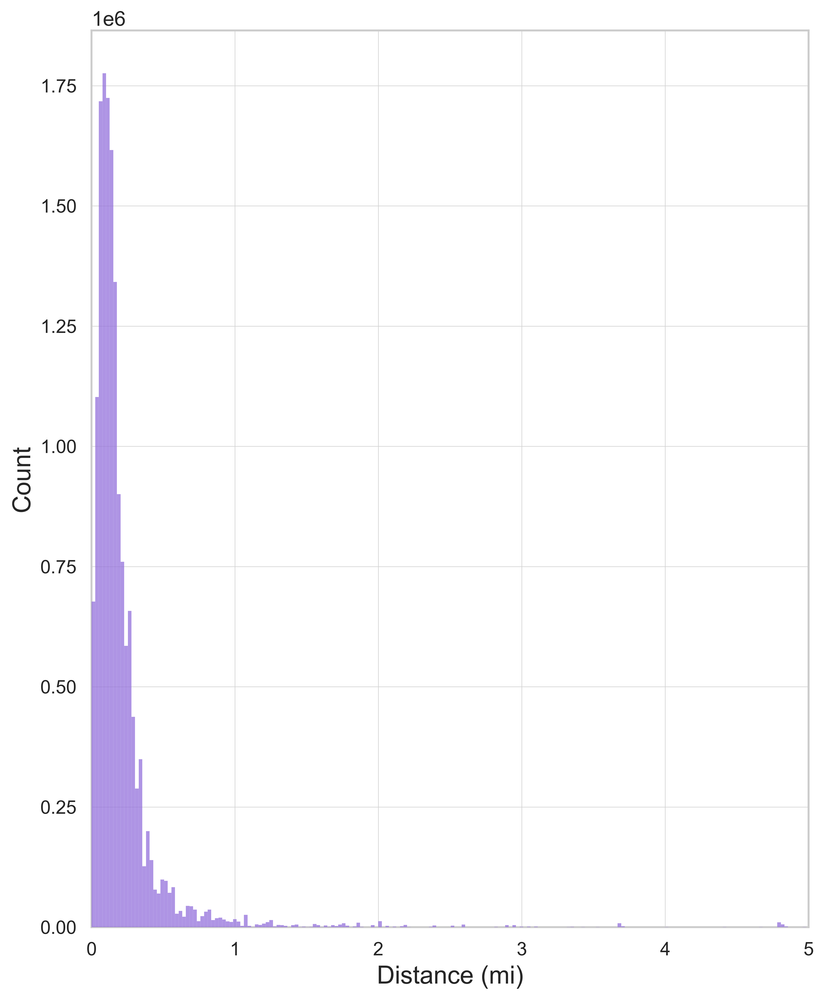

In [424]:
fig = plt.figure(figsize=(8 , 10), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['dist'], 
             bins=2000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Distance (mi)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
plt.xlim(0,5)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))


# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)



# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
fig.savefig(r'../../figures/hist-trajectories-distance-Oct2021toSep2022.png', dpi=600, bbox_inches='tight')


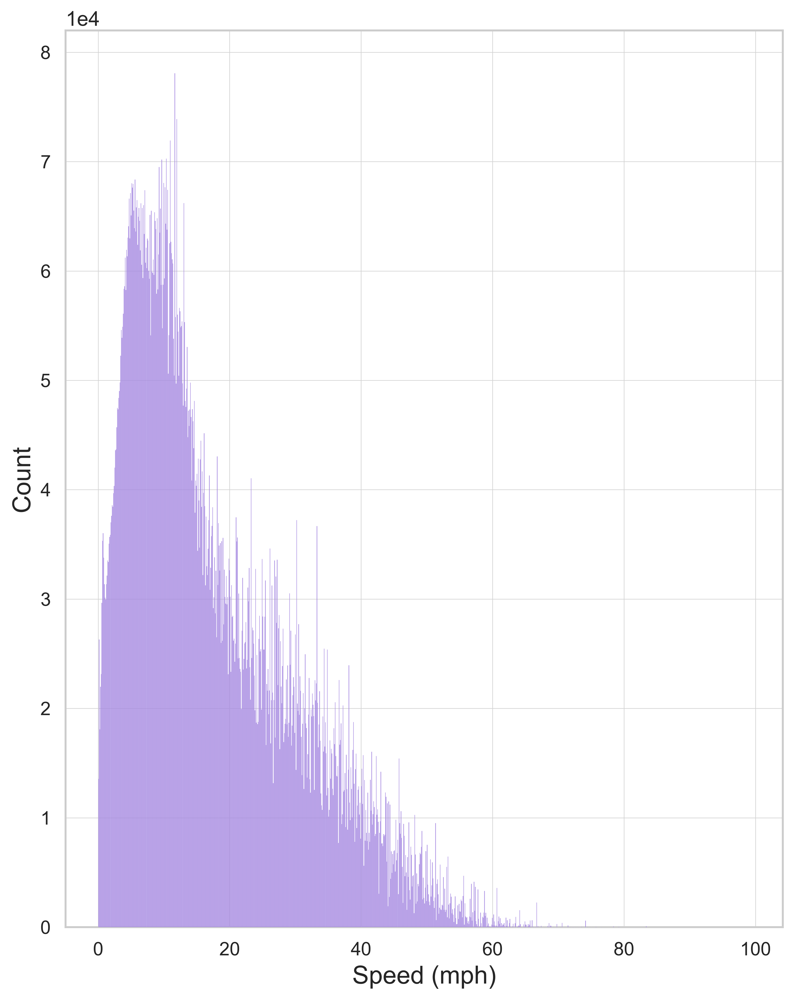

In [425]:
fig = plt.figure(figsize=(8 , 10), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['speed'].loc[df['speed']!=0], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-speed-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


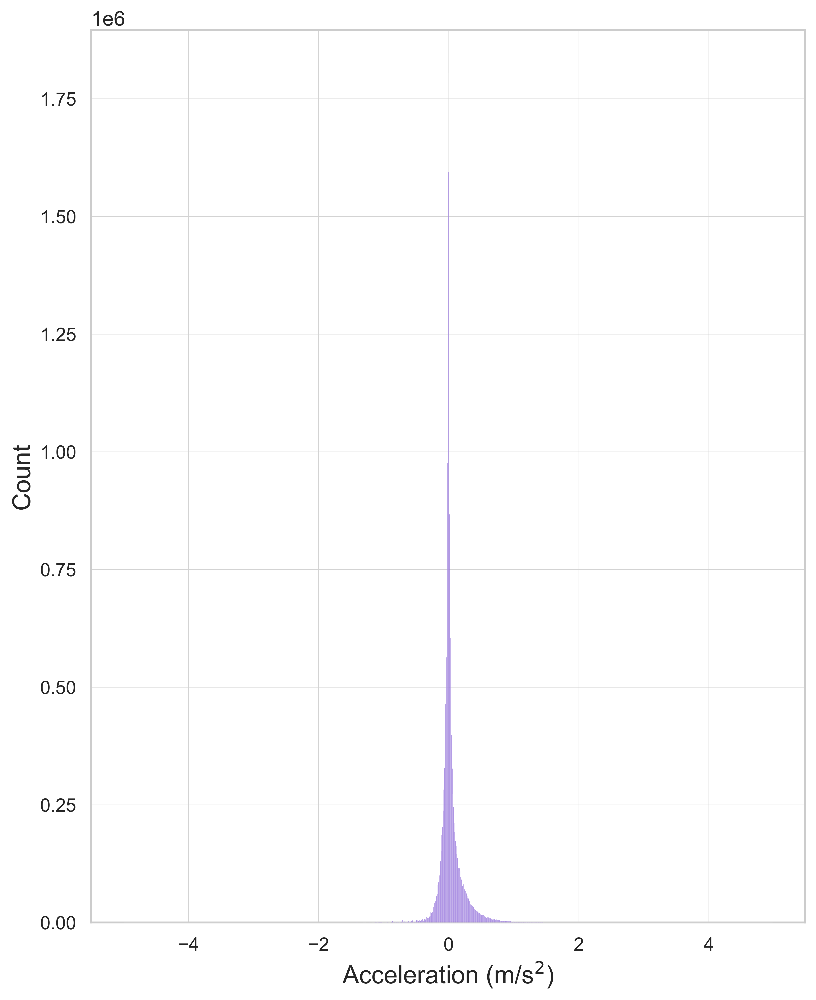

In [426]:
fig = plt.figure(figsize=(8 , 10), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['acc'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-acceleration-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


In [427]:
df['dist'].mean()

0.20990111200608677

In [428]:
df['dist'].median()

0.13869237795671832

In [429]:
df['speed'].mean()

16.673927368287952

In [430]:
df['speed'].median()

13.091222996853082

In [431]:
df['acc'].mean()

0.03319610482806461

In [432]:
df['acc'].median()

0.0

In [368]:
############################################################

In [ ]:
### Do not need to run code from here to the end

In [224]:
# Set the speed threshold
speed_threshold = 100000

# Find rows with speeds higher than the threshold
bad_points = df[df['speed'] > speed_threshold]

# Define a function to plot the trajectory
def plot_trajectory(df, vehicle, date, index):
    temp_df = df[(df['Vehicle'] == vehicle) & (df['Date'] == date)]
    current_index = temp_df.index.get_loc(index)
    
    start = max(current_index - 3, 0)
    end = min(current_index + 4, len(temp_df))
    
    subset = temp_df.iloc[start:end]
    
    plt.figure(figsize=(10, 6))
    plt.plot(subset['Lon'], subset['Lat'], marker='o', markersize=5, linestyle='-')
    
    for i, row in subset.iterrows():
        plt.text(row['Lon'], row['Lat'], f" {row['Route']}", fontsize=9)
    
    plt.scatter(subset.loc[index]['Lon'], subset.loc[index]['Lat'], color='red', marker='x', s=100)
    plt.title(f'Trajectory of Vehicle {vehicle} on {date}')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

# Iterate through bad points and plot the trajectories
for _, row in bad_points.iterrows():
    plot_trajectory(df, row['Vehicle'], row['Date'], row.name)


In [225]:
### check what percentile of dataset consist of speeds larger than 100
# Set the speed threshold
speed_threshold = 100

# Calculate the total number of rows in the dataset
total_rows = len(df)

# Calculate the number of rows with speeds larger than 100
rows_with_speeds_larger_than_100 = len(df[df['speed'] > speed_threshold])

# Calculate the percentile of the dataset with speeds larger than 100
percentile = (rows_with_speeds_larger_than_100 / total_rows) * 100

print(f"{percentile}% of the dataset has speeds larger than 80.")

0.003439327062293656% of the dataset has speeds larger than 80.


In [226]:
### Linear interpolation of <on and Lat and time delta for the rows with speed above 100

# Set the speed threshold to 100
speed_threshold = 100

# Find rows with speeds higher than the threshold
bad_points = df[df['speed'] > speed_threshold]

# Group the DataFrame by Vehicle and Date
grouped_df = df.groupby(['Vehicle', 'Date'], group_keys=False)

# Define a function for interpolating Lon, Lat, and time_delta_in_seconds
def interpolate_group(group):
    bad_indices = group.index.intersection(bad_points.index)
    
    for idx in bad_indices:
        current_index = group.index.get_loc(idx)
        start = max(current_index - 1, 0)
        end = min(current_index + 2, len(group))
        
        subset = group.iloc[start:end]
        
        weight_before = (end - start) - 1 - 1
        weight_after = 1

        # Perform linear interpolation for Longitude, Latitude, and time_delta_in_seconds
        interpolated_lon = (weight_before * subset.iloc[0]['Lon'] + weight_after * subset.iloc[-1]['Lon']) / (weight_before + weight_after)
        interpolated_lat = (weight_before * subset.iloc[0]['Lat'] + weight_after * subset.iloc[-1]['Lat']) / (weight_before + weight_after)
        interpolated_time_delta = (weight_before * subset.iloc[0]['time_delta_in_seconds'] + weight_after * subset.iloc[-1]['time_delta_in_seconds']) / (weight_before + weight_after)

        # Update the original dataframe with the interpolated values
        group.loc[idx, 'Lon'] = interpolated_lon
        group.loc[idx, 'Lat'] = interpolated_lat
        group.loc[idx, 'time_delta_in_seconds'] = interpolated_time_delta

        # Update the time_delta_in_seconds of the next row
        if current_index + 1 < len(group):
            next_row_index = group.iloc[current_index + 1].name
            delta_time_difference = interpolated_time_delta - subset.iloc[1]['time_delta_in_seconds']
            group.loc[next_row_index, 'time_delta_in_seconds'] -= delta_time_difference
    
    return group

# Apply the interpolation function to each group
df_interpolated = grouped_df.apply(interpolate_group).reset_index(drop=True)


In [227]:
## vectorized version of computing distances

# Function to compute distances between consecutive rows
def compute_distances(lat1, lon1, lat2, lon2):
    coords1 = np.column_stack((lon1, lat1))
    coords2 = np.column_stack((lon2, lat2))
    distances = np.array([haversine(coord1, coord2, unit='mi') for coord1, coord2 in zip(coords1, coords2)])
    return distances

# Shift the columns to get the next row's data
df_interpolated['Prev_Vehicle'] = df_interpolated['Vehicle'].shift(1)
df_interpolated['Prev_Date'] = df_interpolated['Date'].shift(1)
df_interpolated['Prev_Lat'] = df_interpolated['Lat'].shift(1)
df_interpolated['Prev_Lon'] = df_interpolated['Lon'].shift(1)

# Calculate distances using the compute_distances function
distances = compute_distances(df_interpolated['Prev_Lat'], df_interpolated['Prev_Lon'], df_interpolated['Lat'], df_interpolated['Lon'])

# Set distance to 0 where the vehicle or date is different
same_vehicle = df_interpolated['Vehicle'] == df_interpolated['Prev_Vehicle']
same_date = df_interpolated['Date'] == df_interpolated['Prev_Date']
distances[~(same_vehicle & same_date)] = 0

# Assign the distances to the 'dist' column
df_interpolated['dist'] = distances

# Drop the temporary columns
df_interpolated.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Lat', 'Prev_Lon'], inplace=True)

In [228]:
## vectorized version of computing speeds

# Function to compute speed from distance and time
def compute_speed(distance, time_diff):
    speed = distance / time_diff
    return speed

# Shift the columns to get the previous row's data
df_interpolated['Prev_Vehicle'] = df_interpolated['Vehicle'].shift(1)
df_interpolated['Prev_Date'] = df_interpolated['Date'].shift(1)
df_interpolated['Prev_ServiceDateTime'] = df_interpolated['ServiceDateTime'].shift(1)

# Compute the time difference in hours
time_diff = df_interpolated['ServiceDateTime'] - df_interpolated['Prev_ServiceDateTime']
time_diff_hours = time_diff.dt.total_seconds() / 3600.0

# Calculate speeds using the compute_speed function
speeds = compute_speed(df_interpolated['dist'], time_diff_hours)

# Set speed to 0 where the vehicle or date is different or time_diff_hours is 0
same_vehicle = df_interpolated['Vehicle'] == df_interpolated['Prev_Vehicle']
same_date = df_interpolated['Date'] == df_interpolated['Prev_Date']
valid_time_diff = time_diff_hours != 0
zero_distance = df_interpolated['dist'] == 0

# Assign the speeds to the 'speed' column
df_interpolated['speed'] = speeds

# Set speed to 0 when any of the conditions are not true or distance is 0
df_interpolated.loc[~(same_vehicle & same_date & valid_time_diff) | zero_distance, 'speed'] = 0

# Drop the temporary columns
df_interpolated.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_ServiceDateTime'], inplace=True)


In [229]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df_interpolated['Prev_Vehicle'] = df_interpolated['Vehicle'].shift(1)
df_interpolated['Prev_Date'] = df_interpolated['Date'].shift(1)
df_interpolated['Prev_Speed'] = df_interpolated['speed'].shift(1)
df_interpolated['Prev_ServiceDateTime'] = df_interpolated['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df_interpolated['ServiceDateTime'] - df_interpolated['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df_interpolated['speed'] - df_interpolated['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df_interpolated['Vehicle'] == df_interpolated['Prev_Vehicle']
same_date = df_interpolated['Date'] == df_interpolated['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df_interpolated['acc'] = accelerations

# Drop the temporary columns
df_interpolated.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
#df.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')


In [230]:
start_time = pd.to_datetime('2022-08-23 05:00:00', format='%Y-%m-%d %H:%M:%S')
end_time = pd.to_datetime('2022-08-24 05:00:00', format='%Y-%m-%d %H:%M:%S')

plot_data_modified = df_interpolated.loc[(df_interpolated['ServiceDateTime'] >= start_time) & (df_interpolated['ServiceDateTime'] < end_time)].copy()
#plot_data_modified

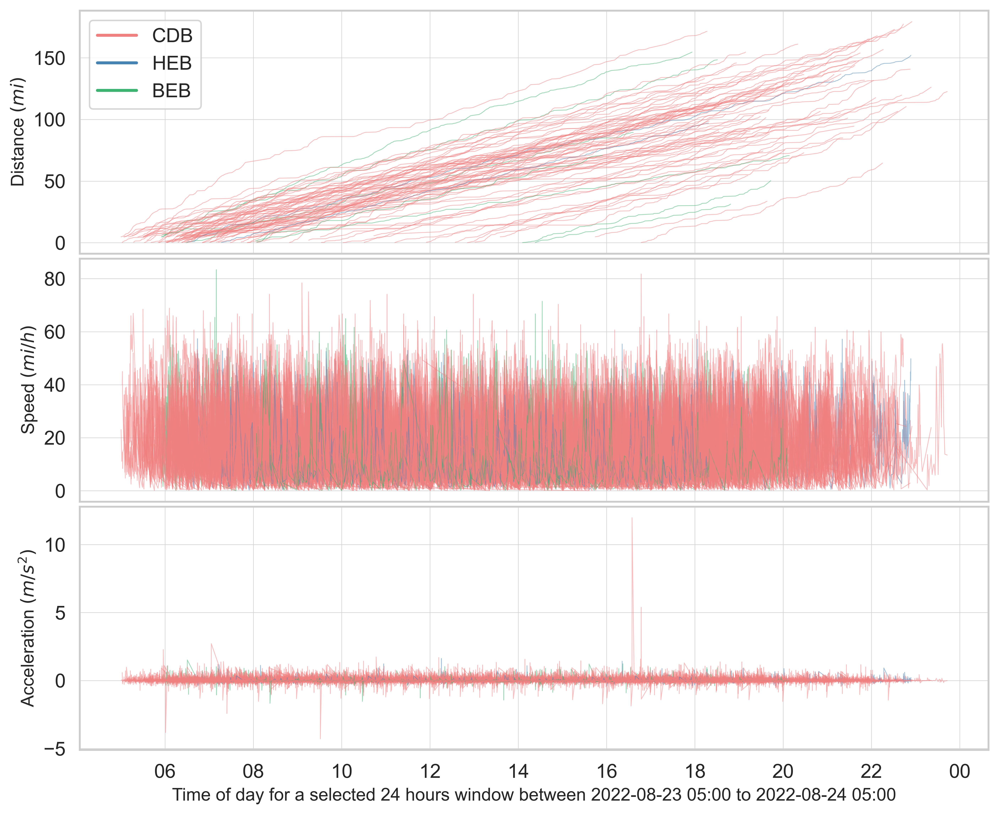

In [231]:
from matplotlib.dates import date2num

# make a facet plot
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].set_ylabel(r'Speed $(mi/h)$')

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].set_ylabel(r'Acceleration $(m/s^2)$')

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

In [232]:
df_interpolated['speed'].max()

6544.189295666796

In [234]:
### check what percentile of dataset consist of speeds larger than 100
# Set the speed threshold
speed_threshold = 100

# Calculate the total number of rows in the dataset
total_rows = len(df)

# Calculate the number of rows with speeds larger than 100
rows_with_speeds_larger_than_100 = len(df_interpolated[df_interpolated['speed'] > speed_threshold])

# Calculate the percentile of the dataset with speeds larger than 100
percentile = (rows_with_speeds_larger_than_100 / total_rows) * 100

print(f"{percentile}% of the dataset has speeds larger than 100.")

0.002072579554329946% of the dataset has speeds larger than 80.


In [ ]:
#### do not need to run the code from here to the end

In [156]:
df_interpolated['Stop'].loc[df_interpolated['speed']>30000]

14544316    0
15576074    0
Name: Stop, dtype: int64

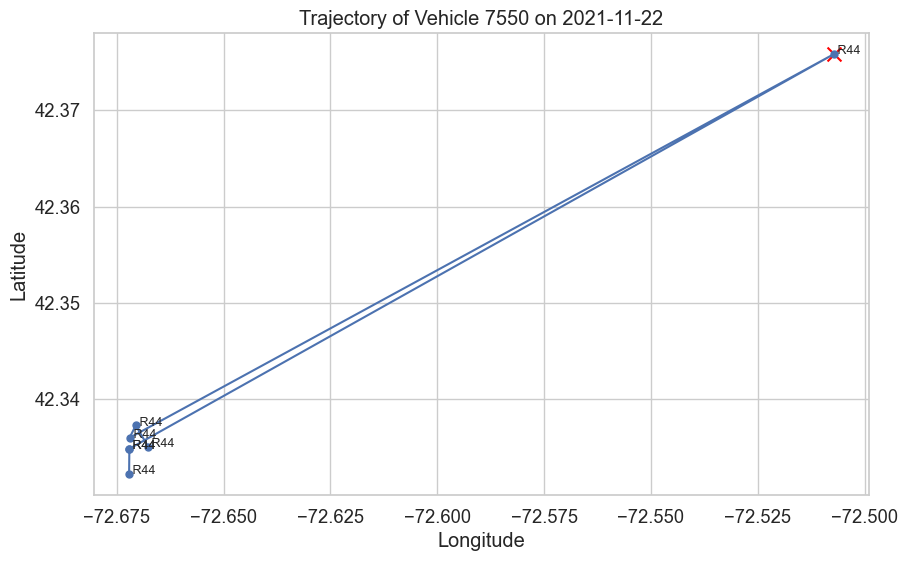

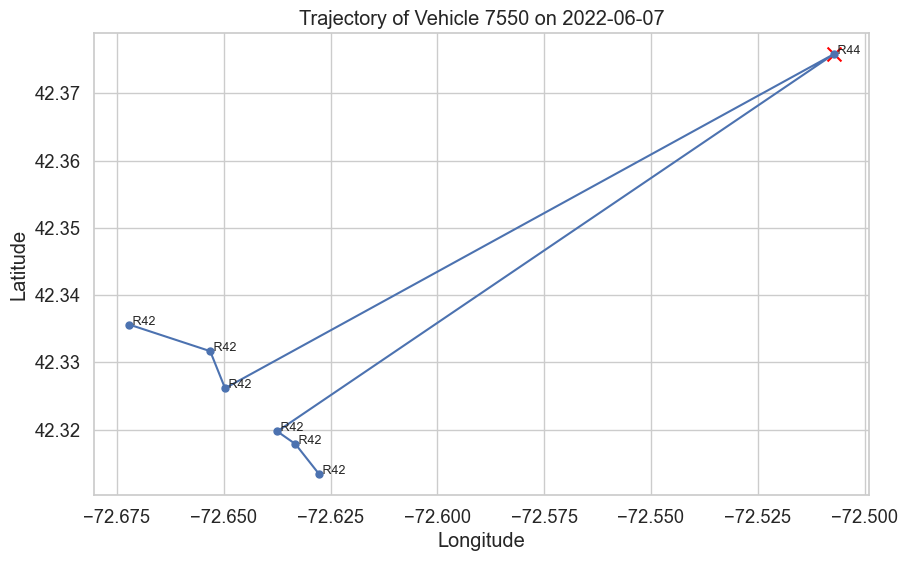

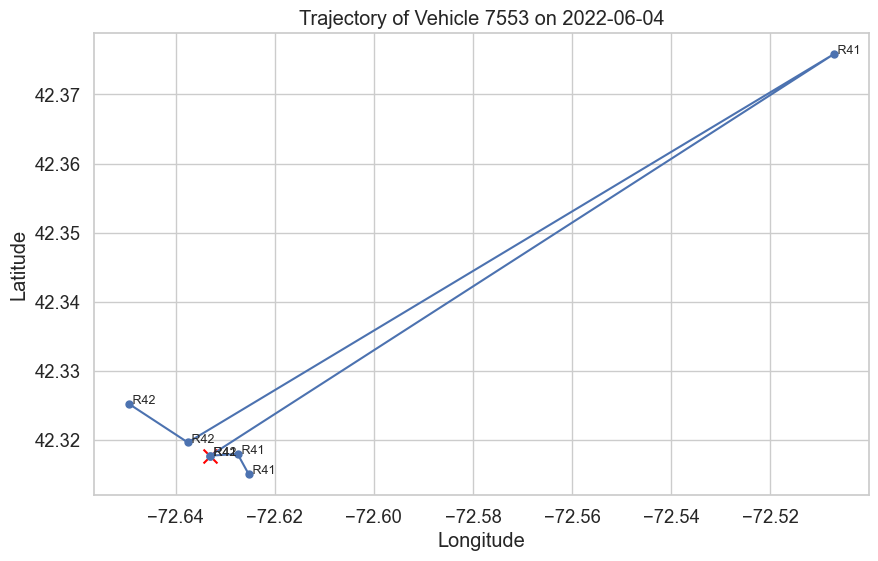

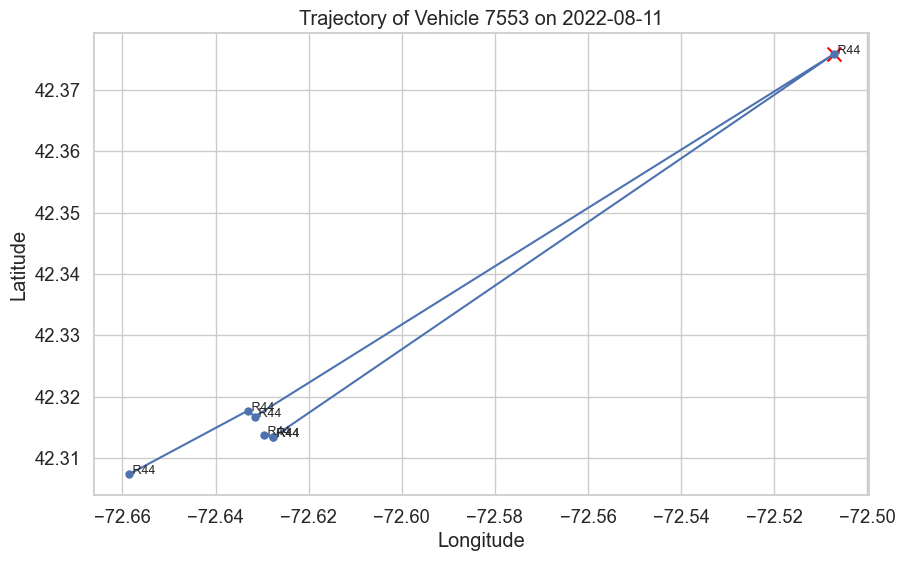

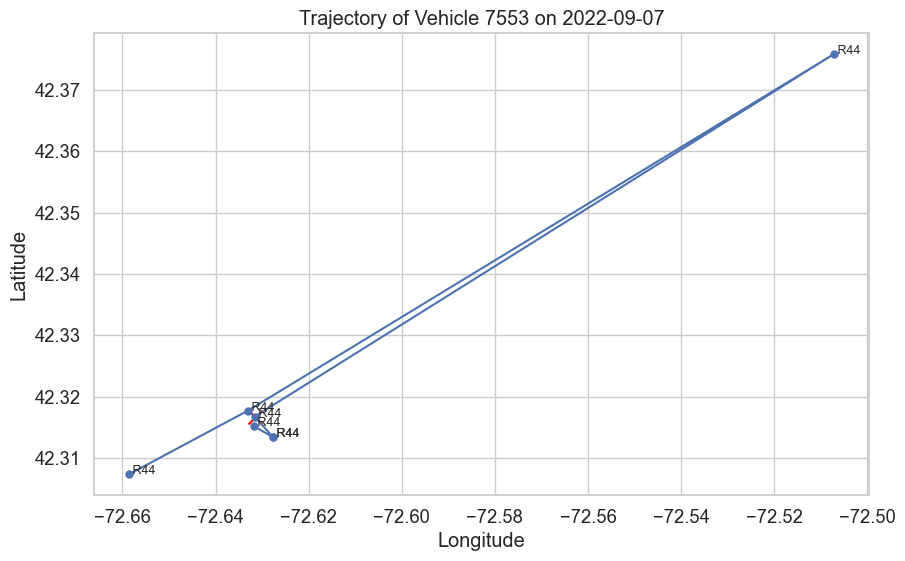

...

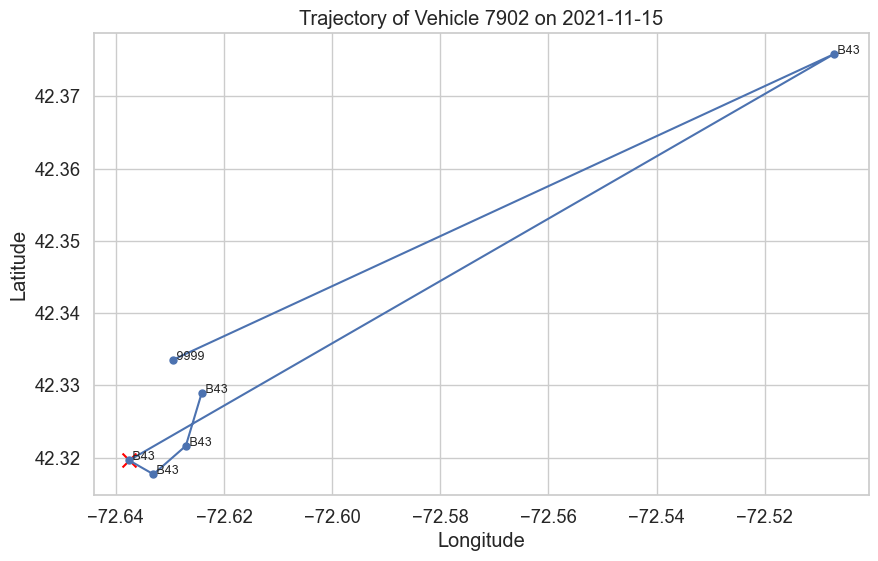

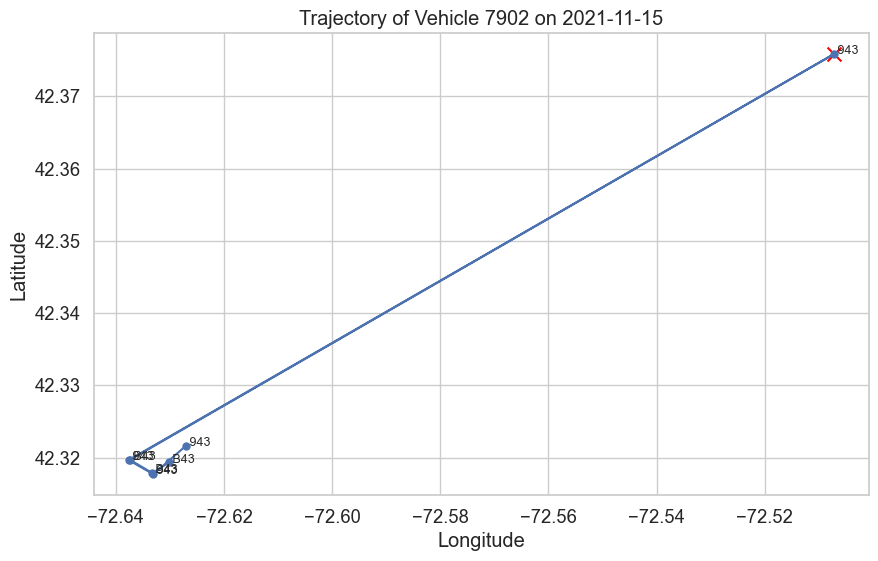

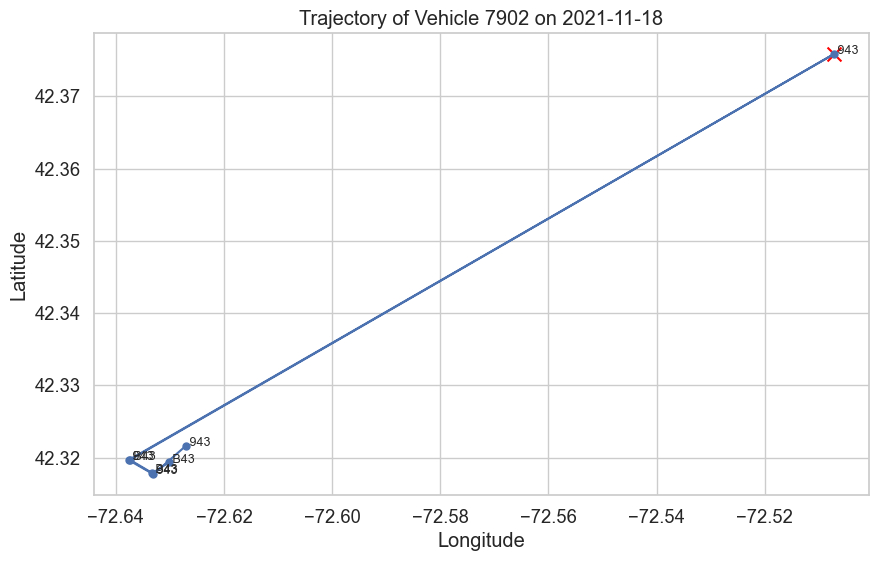

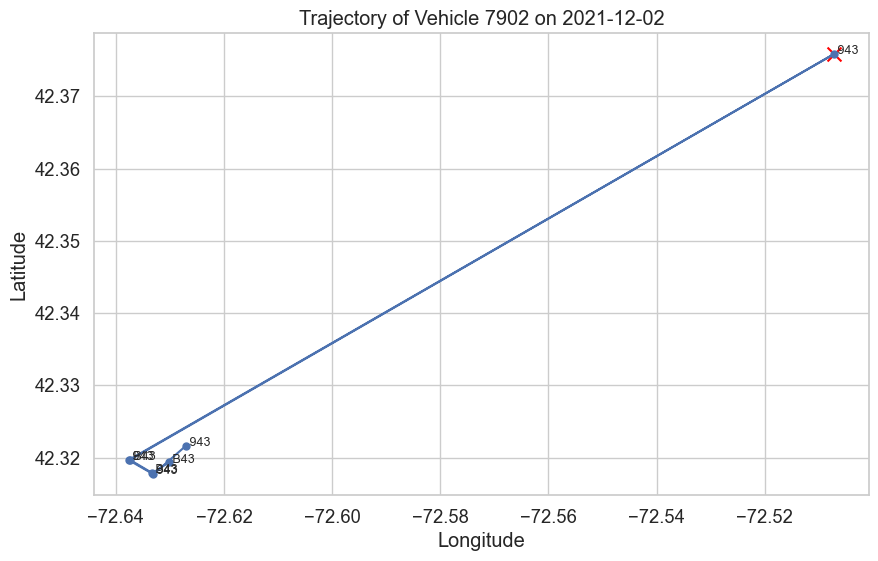

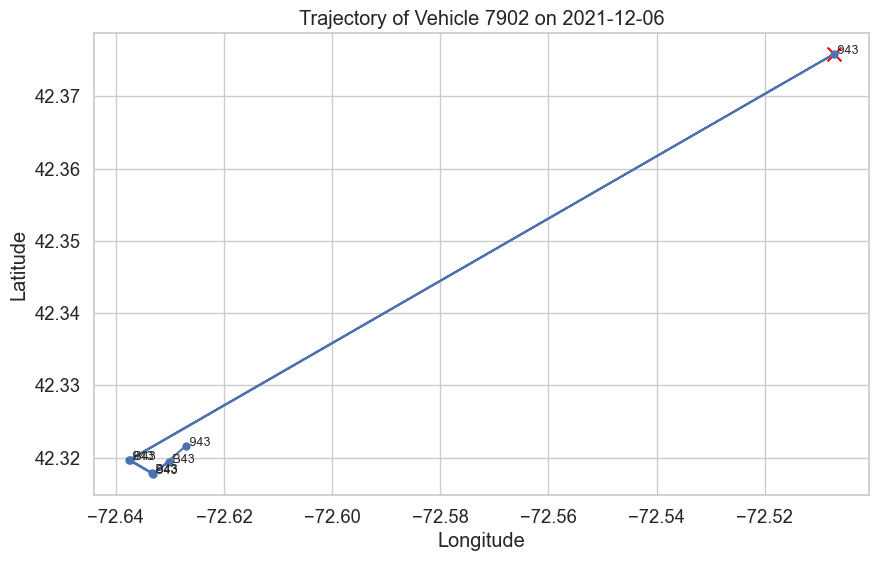

In [152]:
# Set the speed threshold
speed_threshold = 30000

# Find rows with speeds higher than the threshold
bad_points = df[df['speed'] > speed_threshold]

# Define a function to plot the trajectory
def plot_trajectory(df, vehicle, date, index):
    temp_df = df[(df['Vehicle'] == vehicle) & (df['Date'] == date)]
    current_index = temp_df.index.get_loc(index)
    
    start = max(current_index - 3, 0)
    end = min(current_index + 4, len(temp_df))
    
    subset = temp_df.iloc[start:end]
    
    plt.figure(figsize=(10, 6))
    plt.plot(subset['Lon'], subset['Lat'], marker='o', markersize=5, linestyle='-')
    
    for i, row in subset.iterrows():
        plt.text(row['Lon'], row['Lat'], f" {row['Route']}", fontsize=9)
    
    plt.scatter(subset.loc[index]['Lon'], subset.loc[index]['Lat'], color='red', marker='x', s=100)
    plt.title(f'Trajectory of Vehicle {vehicle} on {date}')
    plt.xlabel('Longitude')
    plt.ylabel('Latitude')
    plt.show()

# Iterate through bad points and plot the trajectories
for _, row in bad_points.iterrows():
    plot_trajectory(df, row['Vehicle'], row['Date'], row.name)


In [48]:
# Smooth speeds using a rolling window with a moving average

# Apply smoothing to the speed data using a rolling window and simple moving average
window_size = 3
df['smoothed_speed'] = df.groupby(['Vehicle', 'Date'])['speed'].rolling(window=window_size, min_periods=1).mean().reset_index(drop=True)

In [49]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Speed'] = df['smoothed_speed'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df['smoothed_speed'] - df['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df['acc'] = accelerations

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
#df.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')

In [53]:
plot_data_modified = df.loc[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)].copy()

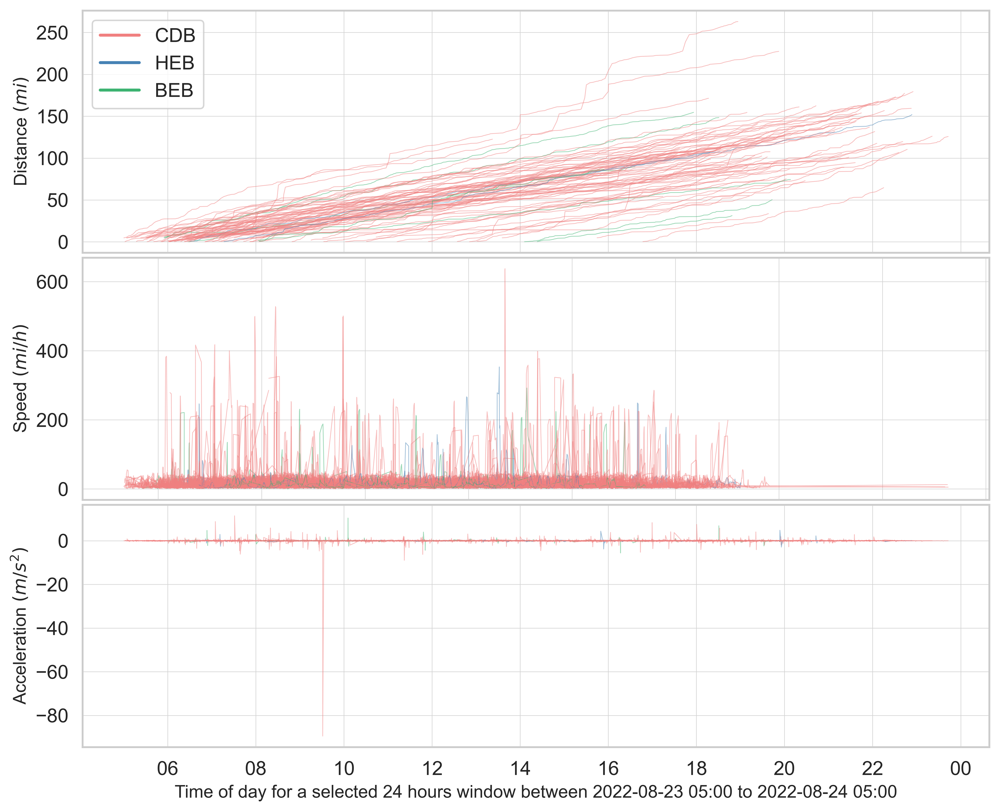

In [54]:
# make a facet plot
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['smoothed_speed'].notnull()) & (plot_df['smoothed_speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].set_ylabel(r'Speed $(mi/h)$')

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].set_ylabel(r'Acceleration $(m/s^2)$')

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
#fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

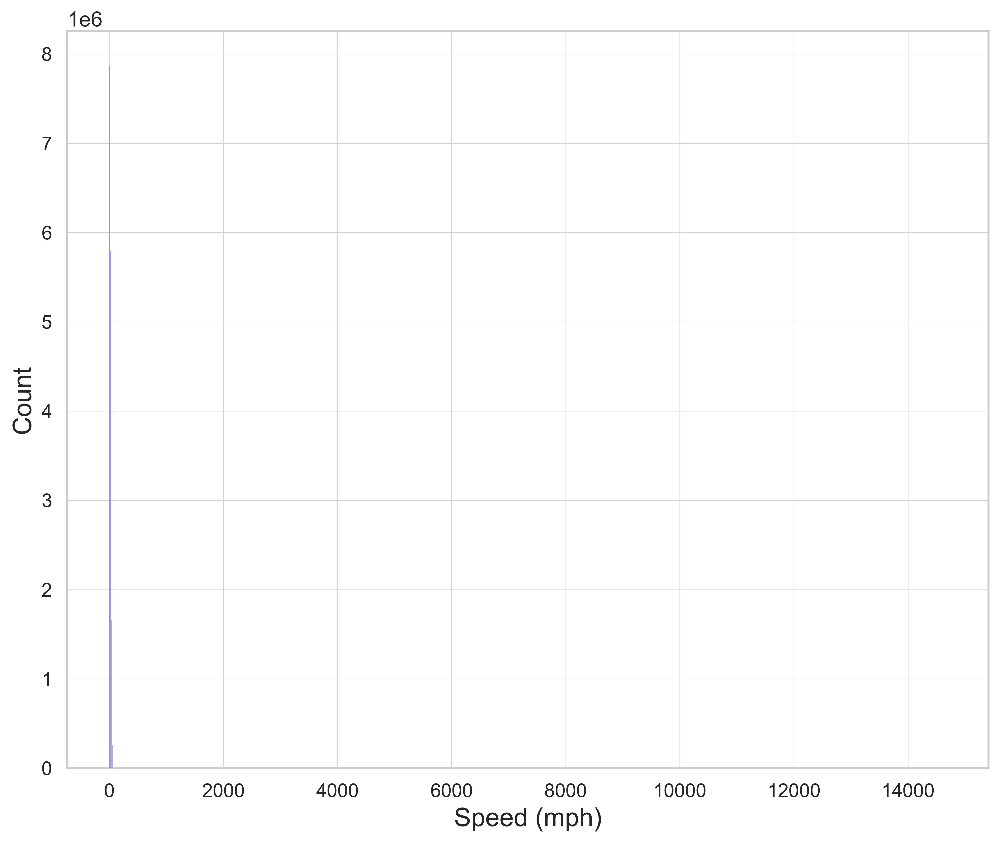

In [55]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['smoothed_speed'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-smoothed-speed-averaging-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')


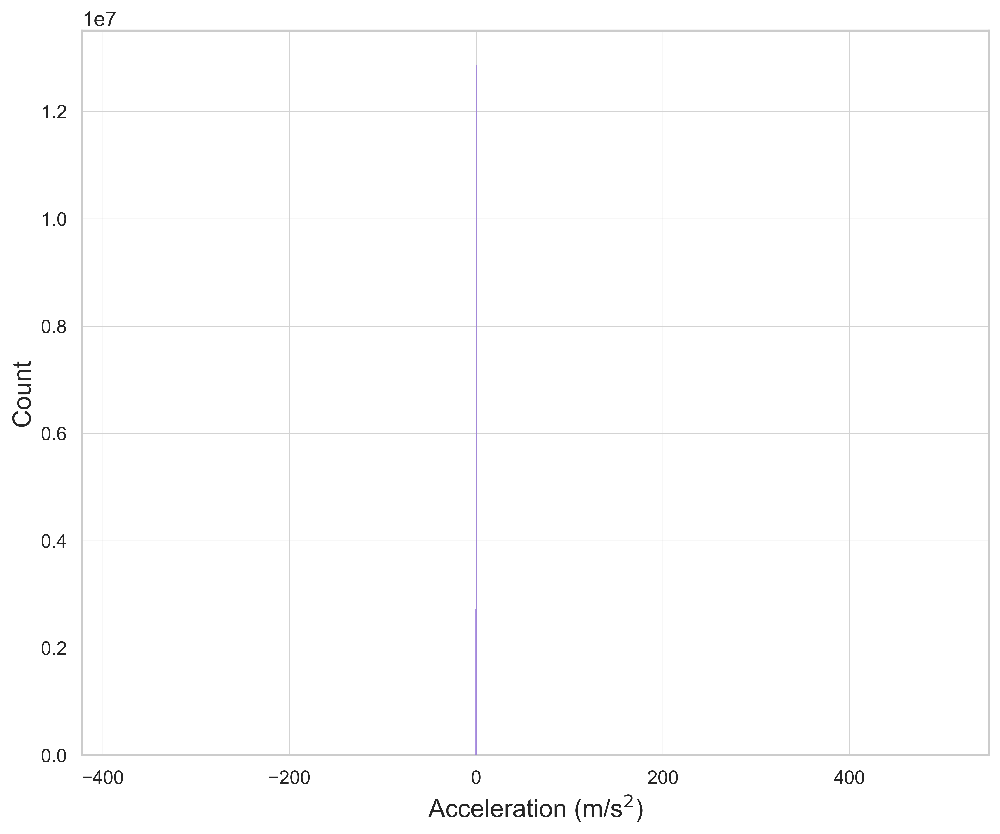

In [56]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['acc'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-smoothed-acceleration-averaging-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')

In [85]:
# Using Gaussian kernel to smooth speeds

from scipy.ndimage import gaussian_filter1d

# Function to apply Gaussian kernel smoothing
def gaussian_kernel_smoothing(data, sigma):
    return gaussian_filter1d(data, sigma)

# Apply Gaussian kernel smoothing to the speed data
sigma = 20
df['smoothed_speed'] = df.groupby(['Vehicle', 'Date'])['speed'].transform(lambda x: gaussian_kernel_smoothing(x, sigma))

In [86]:
plot_data_modified = df.loc[(df['ServiceDateTime'] >= start_time) & (df['ServiceDateTime'] < end_time)].copy()

In [87]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df['Prev_Vehicle'] = df['Vehicle'].shift(1)
df['Prev_Date'] = df['Date'].shift(1)
df['Prev_Speed'] = df['smoothed_speed'].shift(1)
df['Prev_ServiceDateTime'] = df['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df['ServiceDateTime'] - df['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df['smoothed_speed'] - df['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df['Vehicle'] == df['Prev_Vehicle']
same_date = df['Date'] == df['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df['acc'] = accelerations

# Drop the temporary columns
df.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
#df.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')


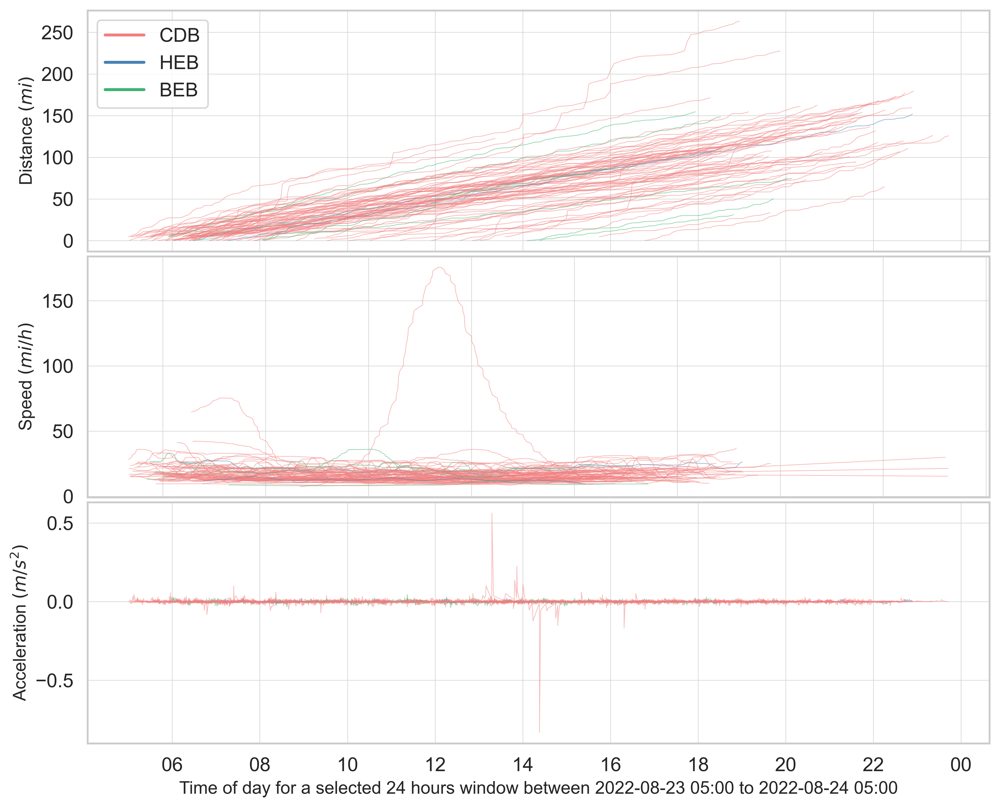

In [88]:
# make a facet plot
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['smoothed_speed'].notnull()) & (plot_df['smoothed_speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["smoothed_speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].set_ylabel(r'Speed $(mi/h)$')

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].set_ylabel(r'Acceleration $(m/s^2)$')

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
#fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

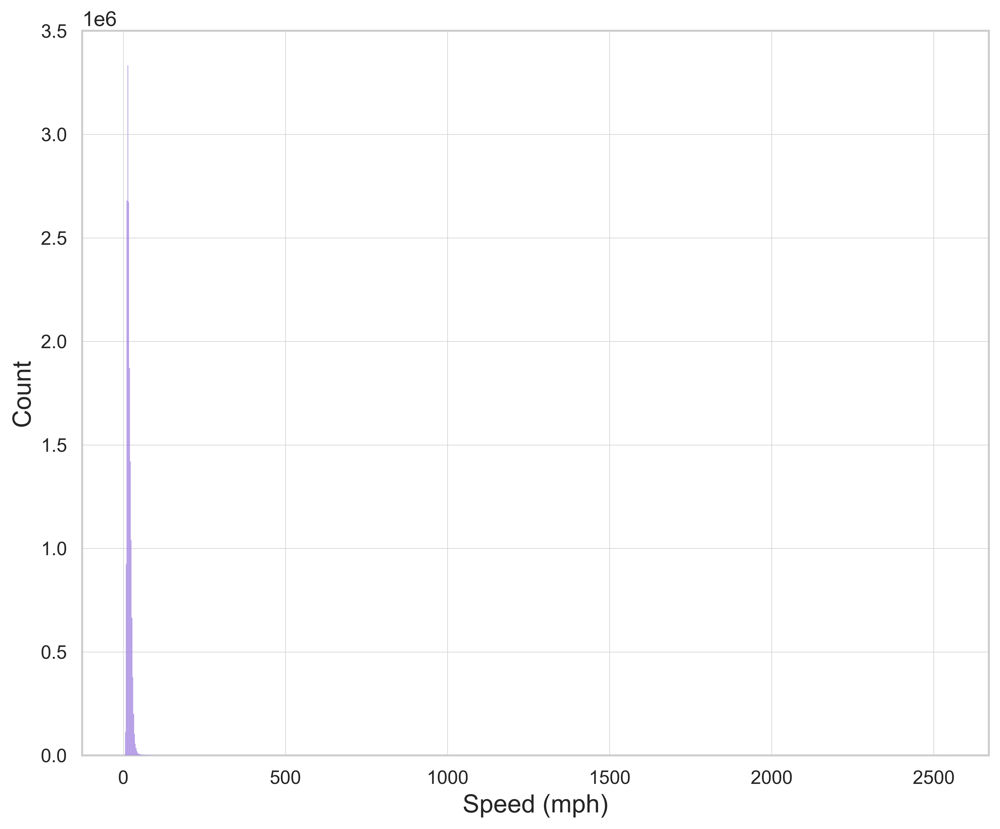

In [65]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['smoothed_speed'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Speed (mph)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-smoothed-speed-gaussian-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')

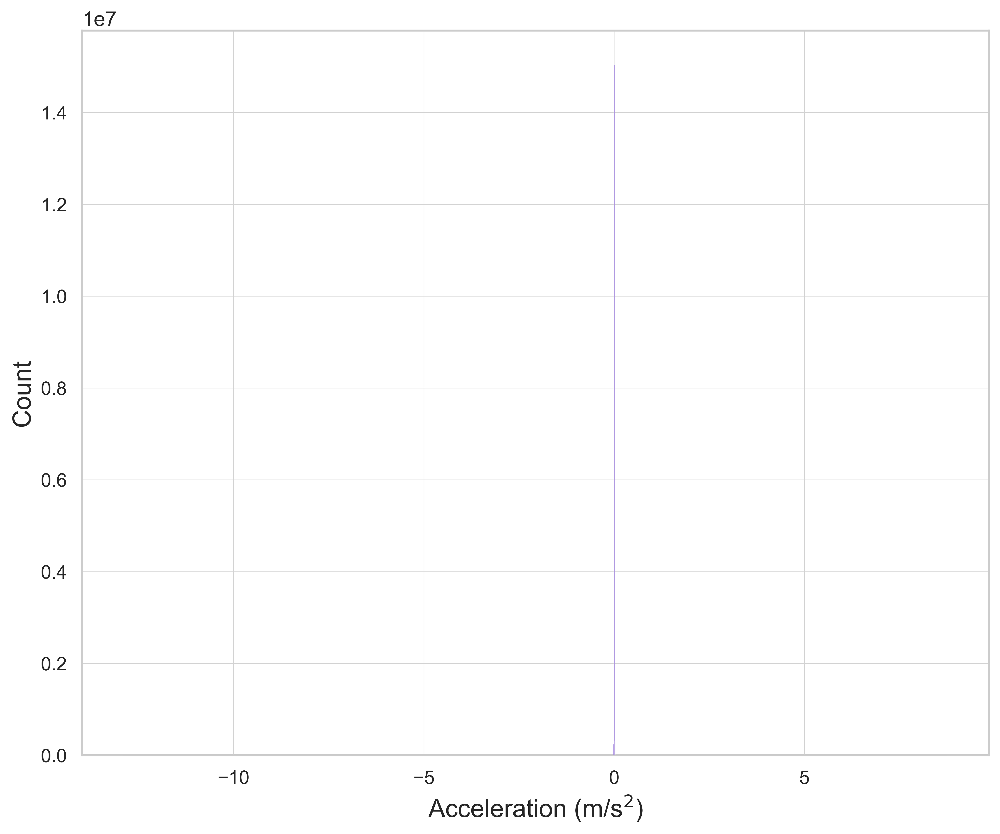

In [66]:
fig = plt.figure(figsize=(10 , 8), dpi=600)


# set style and font size
sns.set(style='whitegrid', font_scale=1.2)

# create histogram with curve
ax=sns.histplot(df['acc'], 
             bins=1000, 
             color='mediumpurple',
             zorder=3)  # use the purple color for the histogram

plt.xlabel('Acceleration (m/s$^2$)', fontsize=16)
plt.ylabel('Count', fontsize=16)
plt.xticks(fontsize=12)
plt.yticks(fontsize=12)
#plt.xlim(0,100)
plt.ticklabel_format(style='sci', axis='y', scilimits=(0,0))



# add gridlines
plt.grid(color='lightgrey', linewidth=0.4)


# adjust size and spacing
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1)

# save figure
plt.savefig(r'../../figures/hist-trajectories-smoothed-acceleration-gaussian-Oct2021toSep2022.png', dpi=400, bbox_inches='tight')

In [ ]:
df['dist'].mean()

In [ ]:
df['speed'].mean()

In [ ]:
# Group the dataframe by 'Vehicle' and calculate the mean of 'time_delta_in_seconds'
mean_time_delta_per_vehicle = df.groupby('Vehicle')['time_delta_in_seconds'].mean()

# Display the result
mean_time_delta_per_vehicle

# Calculate the mean of all values in mean_time_delta_per_vehicle
overall_mean_time_delta = mean_time_delta_per_vehicle.mean()

# Display the result
overall_mean_time_delta

In [ ]:
df.loc[(df['time_delta_in_seconds'] < 10) & (df['time_delta_in_seconds'] != 0)]

In [ ]:
# Get the rows with the largest 8 values in the 'speed' column
largest_rows = df[df['speed'].isin(df['speed'].nlargest(8))]

largest_rows

In [ ]:
# Get the indices of the rows with the largest 10 values in the 'speed' column
largest_indices = df['speed'].nlargest(10).index

# Get the indices of the rows before the largest rows
previous_indices = largest_indices - 1

# Combine the largest_indices and previous_indices
combined_indices = largest_indices.union(previous_indices)

# Get the rows with the combined indices and sort them by index
largest_rows_and_previous = df.loc[combined_indices].sort_index()

# Display the rows
largest_rows_and_previous[['Vehicle','Stop','time_delta_in_seconds','dist','speed','acc']]


In [ ]:
df.columns

In [68]:
df[df['time_delta_in_seconds']<2]

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb),time_delta_in_seconds,dist,speed,acc,smoothed_speed
1365147,1365147,1365147,2021-10-01 06:43:49,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,...,49,2021-10-01,conventional,Gillig 30,25700,0,0.0,0.0,0.0,17.175358
1365830,1365830,1365830,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,53,2021-10-01,conventional,Gillig 30,25700,0,0.0,0.0,0.0,17.283344
1365844,1365844,1365844,2021-10-01 07:20:33,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,33,2021-10-01,conventional,Gillig 30,25700,0,0.0,0.0,0.0,19.718652
1365861,1365861,1365861,2021-10-01 07:50:45,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,45,2021-10-01,conventional,Gillig 30,25700,0,0.0,0.0,0.0,18.965609
1365875,1365875,1365875,2021-10-01 08:21:34,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,34,2021-10-01,conventional,Gillig 30,25700,0,0.0,0.0,0.0,18.353197
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15569012,15569012,15569012,2022-09-30 20:15:53,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,53,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,0,0.0,0.0,0.0,9.954410
15569072,15569072,15569072,2022-09-30 21:15:11,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,11,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,0,0.0,0.0,0.0,21.469228
15569161,15569161,15569161,2022-09-30 22:01:01,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,1,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,0,0.0,0.0,0.0,9.950170
15569192,15569192,15569192,2022-09-30 22:50:10,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,10,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,0,0.0,0.0,0.0,23.328211


In [69]:
df

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb),time_delta_in_seconds,dist,speed,acc,smoothed_speed
1365147,1365147,1365147,2021-10-01 06:43:49,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,...,49,2021-10-01,conventional,Gillig 30,25700,0,0.000000,0.000000,0.000000,17.175358
1365148,1365148,1365148,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3386,...,53,2021-10-01,conventional,Gillig 30,25700,484,0.594143,4.419242,0.000021,17.211767
1365830,1365830,1365830,2021-10-01 06:51:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,53,2021-10-01,conventional,Gillig 30,25700,0,0.000000,0.000000,0.000000,17.283344
1365831,1365831,1365831,2021-10-01 06:52:53,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,53,2021-10-01,conventional,Gillig 30,25700,60,0.313297,18.797798,0.000485,17.388202
1365832,1365832,1365832,2021-10-01 06:54:38,8578,2021-10-01 00:00:00.000,2021,10,1,VATCo,3387,...,38,2021-10-01,conventional,Gillig 30,25700,105,0.421870,14.464099,0.000355,17.522530
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15569308,15569308,15569308,2022-09-30 23:56:37,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,37,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,31,0.124876,14.501714,0.004709,19.098983
15569309,15569309,15569309,2022-09-30 23:56:58,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,58,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,21,0.235011,40.287655,0.005820,19.538993
15569310,15569310,15569310,2022-09-30 23:58:24,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,24,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,86,1.075675,45.028269,0.001103,19.880579
15569311,15569311,15569311,2022-09-30 23:58:42,8942,2022-09-30 00:00:00.000,2022,9,1,VATCo,3995,...,42,2022-09-30,hybrid,NEW FLYER XDE60 (ARTIC),42250,18,0.198054,39.610868,0.003601,20.113899


In [115]:
df_trimed=df_initial.copy()

In [116]:
df_trimed=df_trimed.loc[df_trimed['Stop']!=0]

In [117]:
df_trimed

,Unnamed: 0.1,Unnamed: 0,ServiceDateTime,DateKey,CalendarDate,Year,Month,OpKey,Operator,RtKey,...,Onboard,Bike,Daytype,Hour,Minute,Second,Date,Powertrain,VehicleModel,VehiclWeight(lb)
0,0,0,2022-04-01 02:54:19,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,0,0,Weekday,2,54,19,2022-04-01,hybrid,NEW FLYER XDE60 (ARTIC),42250
1,1,1,2022-04-01 05:48:20,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,0,0,Weekday,5,48,20,2022-04-01,conventional,NEW FLYER XD40,28250
2,2,2,2022-04-01 06:04:45,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,0,0,Weekday,6,4,45,2022-04-01,conventional,NEW FLYER XD40,28250
3,3,3,2022-04-01 06:01:31,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,0,0,Weekday,6,1,31,2022-04-01,conventional,Gillig 40,27180
4,4,4,2022-04-01 06:48:01,8760,2022-04-01 00:00:00.000,2022,4,1,VATCo,3410,...,1,0,Weekday,6,48,1,2022-04-01,conventional,Gillig 40,27180
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15621724,15621724,15621724,2022-09-30 21:13:03,8942,2022-09-30 00:00:00.000,2022,9,3,UMASS,4025,...,0,0,0,21,13,3,2022-09-30,conventional,Gillig 40,27180
15621725,15621725,15621725,2022-09-30 21:14:14,8942,2022-09-30 00:00:00.000,2022,9,3,UMASS,4025,...,0,0,0,21,14,14,2022-09-30,conventional,Gillig 40,27180
15621726,15621726,15621726,2022-09-30 21:16:09,8942,2022-09-30 00:00:00.000,2022,9,3,UMASS,4025,...,0,0,0,21,16,9,2022-09-30,conventional,Gillig 40,27180
15621727,15621727,15621727,2022-09-30 21:16:46,8942,2022-09-30 00:00:00.000,2022,9,3,UMASS,4025,...,0,0,0,21,16,46,2022-09-30,conventional,Gillig 40,27180


In [118]:
df_trimed["ServiceDateTime"] = pd.to_datetime(df_trimed['ServiceDateTime'], errors="coerce")

In [119]:
df_trimed.sort_values(by=['Vehicle','ServiceDateTime'], ascending=True, inplace=True)

In [120]:
# Calculate time delta
df_trimed['time_delta'] = df_trimed.groupby(['Vehicle', 'Date'])['ServiceDateTime'].diff()

# Convert time delta to seconds, filling NaN values with 0
df_trimed['time_delta_in_seconds'] = df_trimed['time_delta'].dt.total_seconds().fillna(0).astype(int)

# Drop the 'time_delta' column as it's not needed
df_trimed.drop(columns=['time_delta'], inplace=True)

In [121]:
df_trimed=df_trimed[df_trimed['time_delta_in_seconds']<2].copy()

In [122]:
## vectorized version of computing distances

# Function to compute distances between consecutive rows
def compute_distances(lat1, lon1, lat2, lon2):
    coords1 = np.column_stack((lon1, lat1))
    coords2 = np.column_stack((lon2, lat2))
    distances = np.array([haversine(coord1, coord2, unit='mi') for coord1, coord2 in zip(coords1, coords2)])
    return distances

# Shift the columns to get the next row's data
df_trimed['Prev_Vehicle'] = df_trimed['Vehicle'].shift(1)
df_trimed['Prev_Date'] = df_trimed['Date'].shift(1)
df_trimed['Prev_Lat'] = df_trimed['Lat'].shift(1)
df_trimed['Prev_Lon'] = df_trimed['Lon'].shift(1)

# Calculate distances using the compute_distances function
distances = compute_distances(df_trimed['Prev_Lat'], df_trimed['Prev_Lon'], df_trimed['Lat'], df_trimed['Lon'])

# Set distance to 0 where the vehicle or date is different
same_vehicle = df_trimed['Vehicle'] == df_trimed['Prev_Vehicle']
same_date = df_trimed['Date'] == df_trimed['Prev_Date']
distances[~(same_vehicle & same_date)] = 0

# Assign the distances to the 'dist' column
df_trimed['dist'] = distances

# Drop the temporary columns
df_trimed.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Lat', 'Prev_Lon'], inplace=True)

In [123]:
## vectorized version of computing speeds

# Function to compute speed from distance and time
def compute_speed(distance, time_diff):
    speed = distance / time_diff
    return speed

# Shift the columns to get the previous row's data
df_trimed['Prev_Vehicle'] = df_trimed['Vehicle'].shift(1)
df_trimed['Prev_Date'] = df_trimed['Date'].shift(1)
df_trimed['Prev_ServiceDateTime'] = df_trimed['ServiceDateTime'].shift(1)

# Compute the time difference in hours
time_diff = df_trimed['ServiceDateTime'] - df_trimed['Prev_ServiceDateTime']
time_diff_hours = time_diff.dt.total_seconds() / 3600.0

# Calculate speeds using the compute_speed function
speeds = compute_speed(df_trimed['dist'], time_diff_hours)

# Set speed to 0 where the vehicle or date is different or time_diff_hours is 0
same_vehicle = df_trimed['Vehicle'] == df_trimed['Prev_Vehicle']
same_date = df_trimed['Date'] == df_trimed['Prev_Date']
valid_time_diff = time_diff_hours != 0
zero_distance = df_trimed['dist'] == 0

# Assign the speeds to the 'speed' column
df_trimed['speed'] = speeds

# Set speed to 0 when any of the conditions are not true or distance is 0
df_trimed.loc[~(same_vehicle & same_date & valid_time_diff) | zero_distance, 'speed'] = 0

# Drop the temporary columns
df_trimed.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_ServiceDateTime'], inplace=True)


In [124]:
## vectorized version of computing acc

# Function to compute acceleration from speed difference and time
def compute_acceleration(speed_diff, time_diff):
    acceleration = (speed_diff / time_diff) * 0.277778   # conversion factor from miles/h2 to m/s2
    return acceleration

# Shift the columns to get the previous row's data
df_trimed['Prev_Vehicle'] = df_trimed['Vehicle'].shift(1)
df_trimed['Prev_Date'] = df_trimed['Date'].shift(1)
df_trimed['Prev_Speed'] = df_trimed['speed'].shift(1)
df_trimed['Prev_ServiceDateTime'] = df_trimed['ServiceDateTime'].shift(1)

# Compute the time difference in seconds
time_diff = df_trimed['ServiceDateTime'] - df_trimed['Prev_ServiceDateTime']
time_diff_seconds = time_diff.dt.total_seconds()

# Compute speed difference
speed_diff = df_trimed['speed'] - df_trimed['Prev_Speed']

# Calculate accelerations using the compute_acceleration function
accelerations = compute_acceleration(speed_diff, time_diff_seconds)

# Set acceleration to 0 where the vehicle or date is different or time_diff_seconds is 0
same_vehicle = df_trimed['Vehicle'] == df_trimed['Prev_Vehicle']
same_date = df_trimed['Date'] == df_trimed['Prev_Date']
valid_time_diff = time_diff_seconds != 0
accelerations[~(same_vehicle & same_date & valid_time_diff)] = 0

# Assign the accelerations to the 'acc' column
df_trimed['acc'] = accelerations

# Drop the temporary columns
df_trimed.drop(columns=['Prev_Vehicle', 'Prev_Date', 'Prev_Speed', 'Prev_ServiceDateTime'], inplace=True)

# Save the result to a CSV file
#df_trimed.to_csv(r'../../results/computed-trajectories-Oct2021toSep2022.csv')


In [125]:
plot_data_modified = df_trimed.loc[(df_trimed['ServiceDateTime'] >= start_time) & (df_trimed['ServiceDateTime'] < end_time)].copy()

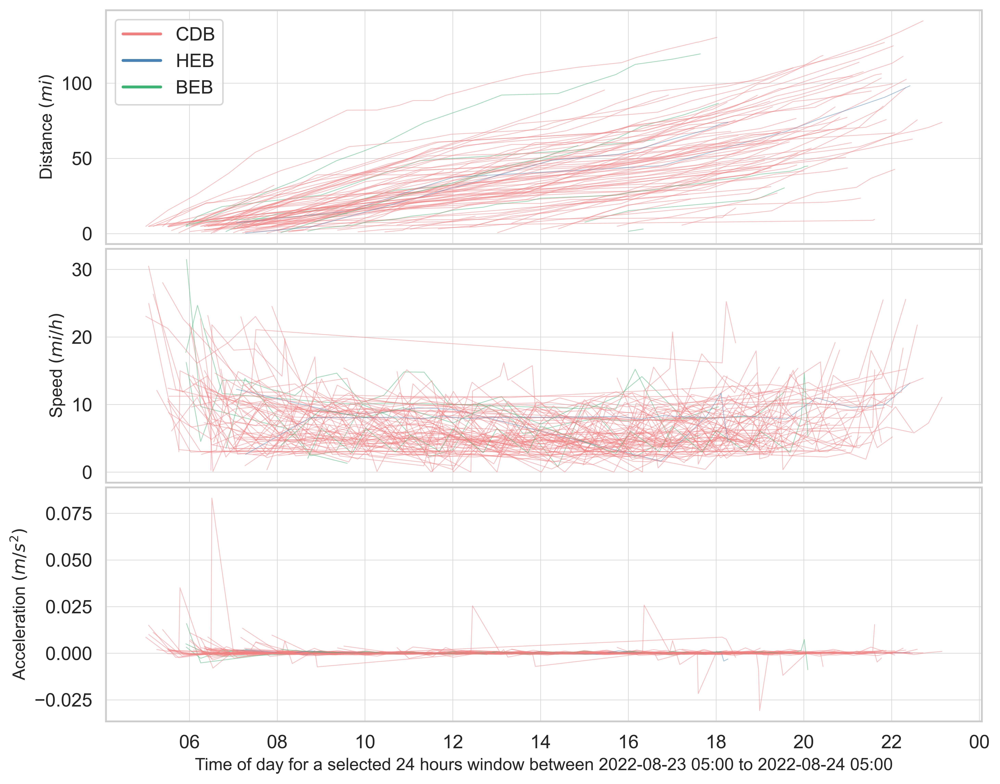

In [126]:
from matplotlib.dates import date2num

# make a facet plot
fig, axs = plt.subplots(nrows=3, ncols=1, figsize=(11, 9), dpi=600)

# Reduce vertical distance between subplots to 0.05 inches
fig.subplots_adjust(hspace=0.02)

# Plot 1: distance vs. time
vehicle = plot_data_modified['Vehicle'].unique()
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['dist'].notnull()) & (plot_df['dist'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[0].plot(plot_df["ServiceDateTime"], plot_df["dist"].cumsum(), marker='', c='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[0].plot(plot_df["dist"].cumsum(), marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
    
axs[0].set_ylabel("Distance (mile)", fontsize=12)
axs[0].set_ylabel(r'Distance $(mi)$')

axs[0].grid(color='lightgrey', linewidth=0.4)
axs[0].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)
# Legend
custom_lines = [Line2D([0], [0], color='lightcoral', lw=2),
                Line2D([0], [0], color='steelblue', lw=2),
                Line2D([0], [0], color='mediumseagreen', lw=2)]
axs[0].legend(custom_lines, ['CDB', 'HEB', 'BEB'])

# Plot 2: speed vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['speed'].notnull()) & (plot_df['speed'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[1].plot(plot_df["ServiceDateTime"], plot_df["speed"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[1].plot(plot_df["speed"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[1].set_ylabel("Speed (mile/hr)", fontsize=12)
axs[1].set_ylabel(r'Speed $(mi/h)$')

axs[1].grid(color='lightgrey', linewidth=0.4)
axs[1].tick_params(axis='x', which='both', bottom=False, top=False, labelbottom=False)

# Plot 3: acceleration vs. time
for v in vehicle:
    plot_df = plot_data_modified[plot_data_modified['Vehicle'] == v]
    plot_df = plot_df.loc[(plot_df['acc'].notnull()) & (plot_df['acc'] != 0)]
    powertrain=plot_df['Powertrain'].max()
    if powertrain=='conventional':  
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='lightcoral', linewidth=0.5, alpha=0.5)
    elif powertrain=='hybrid':
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='steelblue', linewidth=0.5, alpha=0.5)
    else:
        axs[2].plot(plot_df["ServiceDateTime"], plot_df["acc"], marker='', color='mediumseagreen', linewidth=0.5, alpha=0.5)
    #axs[2].plot(plot_df["acc"], marker='', color='#1f77b4', linewidth=0.5, alpha=0.5)
axs[2].set_xlabel("Time of day for a selected 24 hours window between 2022-08-23 05:00 to 2022-08-24 05:00", fontsize=12)
axs[2].set_ylabel("Acceleration (m/s^2)", fontsize=12)
axs[2].set_ylabel(r'Acceleration $(m/s^2)$')

axs[2].grid(color='lightgrey', linewidth=0.4)

date_form = DateFormatter("%H")
axs[2].xaxis.set_major_formatter(date_form)

# Show the combined plot
plt.show()

# Saving
fig.savefig(r'../../figures/trajectories-facet-oct2021-sep2022.png', dpi=600, bbox_inches='tight')

In [1]:
df

NameError: name 'df' is not defined